# Final Project

MIDS W281: Computer Vision

![Teaser](https://raw.githubusercontent.com/W281/fileRepository/main/Assignments/final_project/teaser.png)

 ### Overview
This project will consist of a large dataset including images from 20 different categories. Your task is to identify key distinguishing features of these images and develop models to classify them in Python. To successfully train a classifier we need to do data cleaning, feature exploration, model parameter selection, and model selection. In this project, you will do all of these steps. You will extract different image features, visualize those features, train several models, and explain the process in a report. Most of the concepts, like feature extraction and visualization, are already taught in the class. The classification techniques will be covered soon. We recommend that you start working on the project as early as possible.

### Description

1. **Feature** Extraction: The first step for a classification task is identifying discriminative features. For this, you can use simple features like image intensity or you can extract more sophisticated features like the convolutional neural network (CNN) based features. Additionally, you can use either a single channel or all three color channels for feature computation (image color can sometimes provide an additional cue for classification). Write separate Python functions to extract each of the following image features given an RGB image as input:
    a. Histogram of Oriented Gradients (HOG): This is the feature you learned in the class. You can use Python's sklearn library for extracting this feature. In your report, include plot(s) visualizing the HOG features for an image and explain how you decided the size of the window for HOG computation.
    b. Harris Corner Features: As you learned during motion estimation, image corners are robust features for tracking. One way to detect corners is by using an algorithm by Chris Harris & Mike Stephens, Harris corner detector (suggested [reading](https://docs.opencv.org/3.0-beta/doc/py_tutorials/py_feature2d/py_features_harris/py_features_harris.html#harris-corners)). Again, you can use Python's sklearn or OpenCV implementation of Harris Corner detection algorithms. In your report, include plot(s) visualizing these features for an image and explain how you selected different parameters for the detector.
    c. Two features of your choice: Implement two additional features of your choice which can help in the classification task. These features can be as simple as image intensity or state-of-the-art image classification features extracted using a CNN pre-trained on ImageNet. In your report, include plot(s) in order to explain the features you implemented and why you selected these features.

2. **Feature Visualization**: Load the images provided in the `20_categories_training` directory. The images are divided into 20 categoreis. Visualize the above features for these images on 2-D plots. As these features are high dimensional, you will need to reduce the dimensionality of these features. Remember PCA and t-SNE for dimensionality reduction. You can use any of these dimensionality reduction techniques for visualizing the features on a 2-D plot. You can use only a small set of images from each of the 20 categories. Use Python's sklearn library for t-SNE or PCA. In the 2-D plot, use different colors to represent images from different categories. In your report, include plot(s) to show the visualization of the features (you can also use combination of multiple features) on 2-D plot. Explain which features and dimensionality reduction technique you used for the plots and why. Also, explain if there is anything interesting you observed while exploring the features.   

3. **Image Classification**: Split the images from each category into training and validation dataset. Generally, it is done by randomly selecting 80% images from each class for training and 20% for validation. You will train the models using training data, tune the hyper-parameters for the classifiers using validation dataset. You will train multiple classification models here. For each classification model, you can use sklearn library functions. Use the following classification techniques that you learned in the class using the features you implemented above: Logistic Regression, nearest-neighbor clustering, SVM, and CNN (optional). Use the validation set to compute the accuracy throughout the process, with and without different features, optimizing as much as possible. Use tricks like cross-validation and hyper-parameter tuning to ensure your model is generalizing to validation dataset.   

4. Run the model of your choice (that gives the best accuracy on the validation data) on the test data provided in `20_categories_test` directory. Generate a csv of classification results for all the images. The csv will have two columns: name and label that specify the image name and the output class label. Include this csv in your submission.

### Deliverables:

You will submit your code, classification results on test data, and a report. In the report (maximum three pages), you will explain the process and things you learned in the project. You will be graded on the correctness of the code, clarity of your report, and your model accuracy on the test data.

In [1]:
# importing libraries
import numpy as np
import matplotlib.pyplot as plt
from skimage import color
from skimage.feature import hog
from sklearn import svm
from skimage.transform import resize
from sklearn.metrics import classification_report, accuracy_score
import os
from tqdm import tqdm
from sklearn.linear_model import LogisticRegression
import pandas as pd
from sklearn.model_selection import train_test_split
import cv2
from tensorflow.keras import Model


# Demo Images from each category

In [2]:
#getting the list of categories
categories = os.listdir("./images/20_train/20_categories_training")

In [3]:
# changing the directory
os.chdir("./images")

In [4]:
# listing files in the directory
os.listdir("./20_train")

['20_categories_training']

In [5]:
# viewing the categories
categories

['airplanes',
 'bear',
 'blimp',
 'comet',
 'crab',
 'dog',
 'dolphin',
 'giraffe',
 'goat',
 'gorilla',
 'kangaroo',
 'killer-whale',
 'leopards',
 'llama',
 'penguin',
 'porcupine',
 'teddy-bear',
 'triceratops',
 'unicorn',
 'zebra']

airplanes_0002.jpg


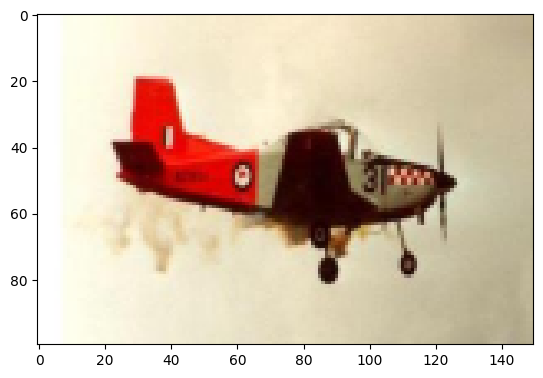

bear_0002.jpg


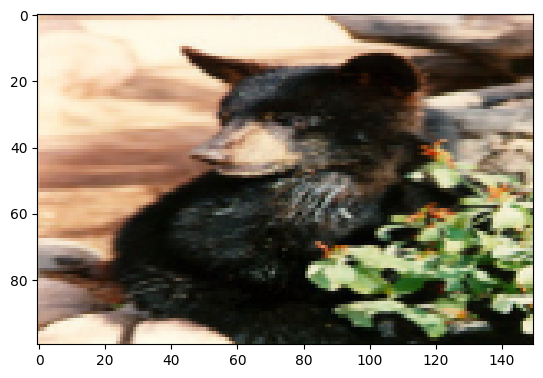

blimp_0002.jpg


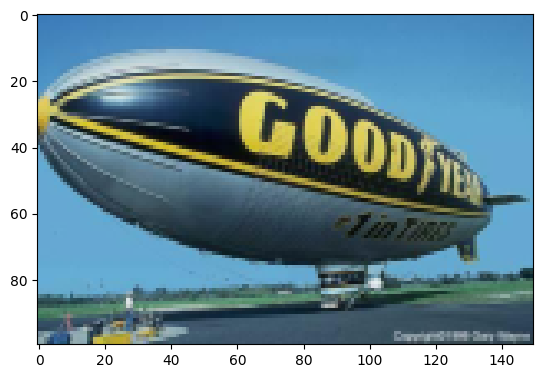

comet_0002.jpg


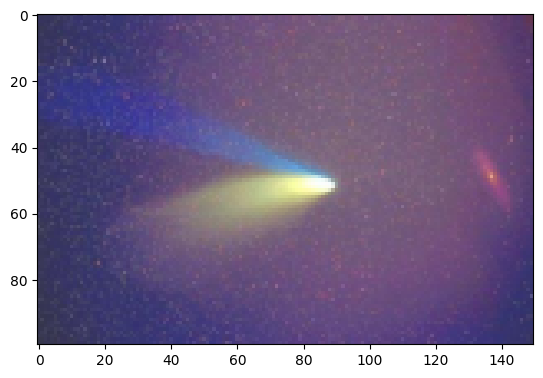

crab_0002.jpg


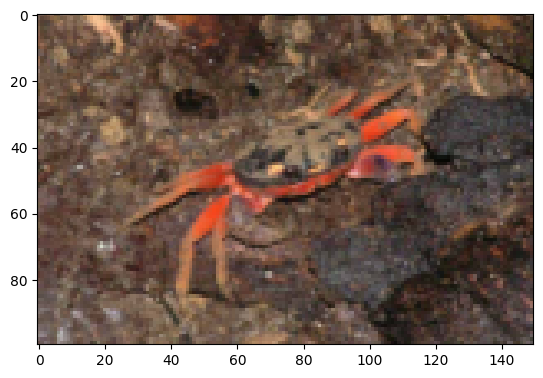

dog_0002.jpg


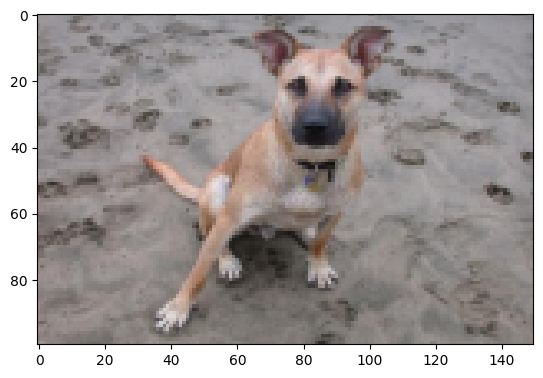

dolphin_0002.jpg


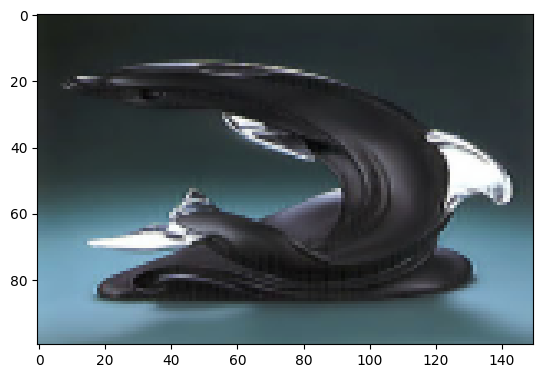

giraffe_0002.jpg


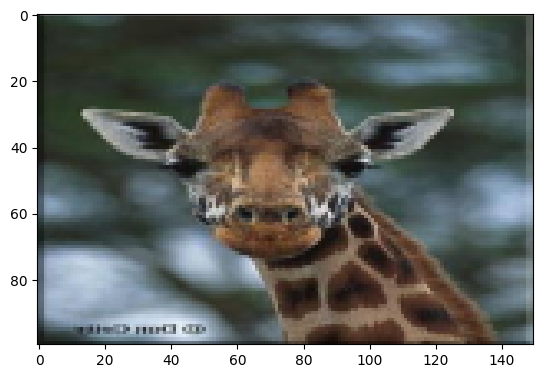

goat_0002.jpg


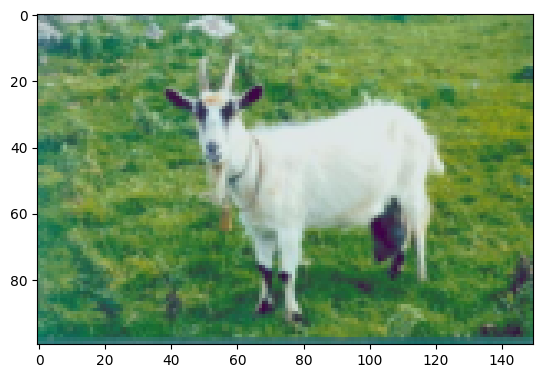

gorilla_0002.jpg


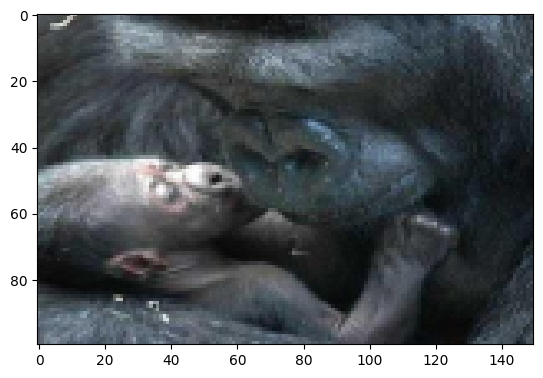

kangaroo_0002.jpg


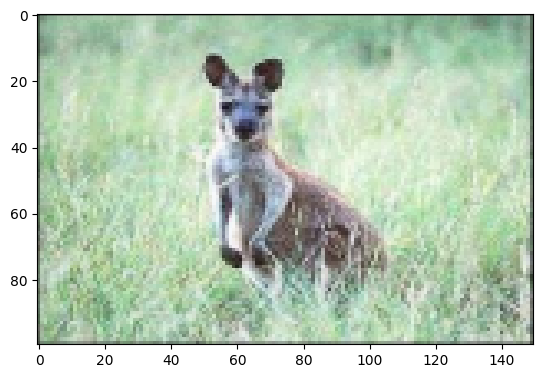

killer-whale_0002.jpg


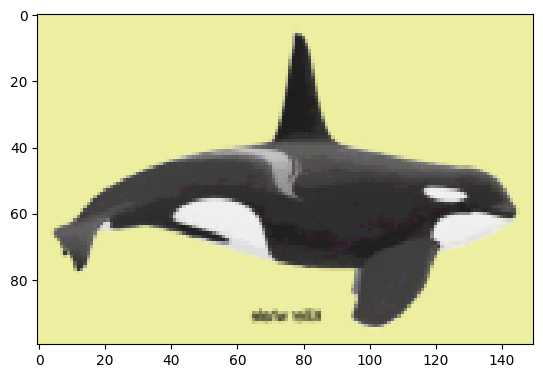

leopards_0002.jpg


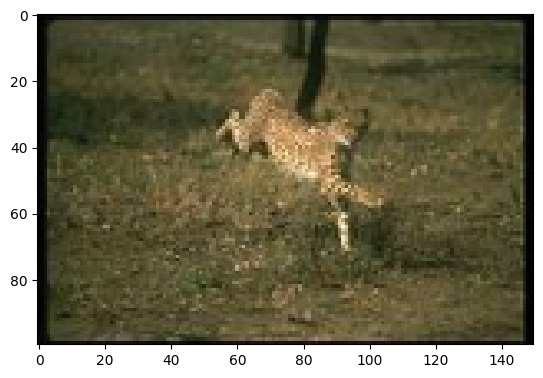

llama_0002.jpg


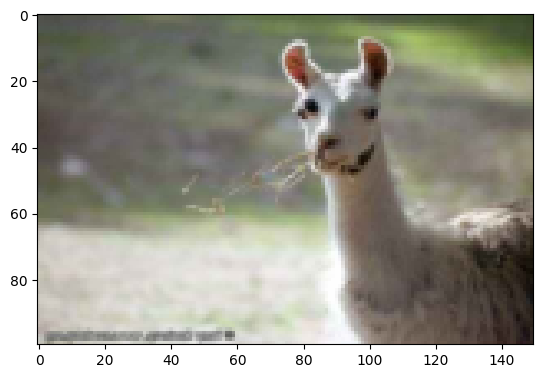

penguin_0002.jpg


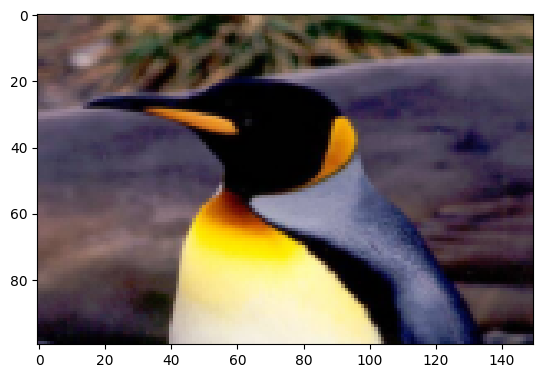

porcupine_0002.jpg


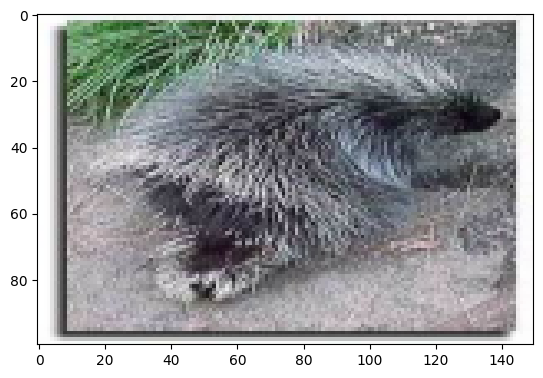

teddy-bear_0002.jpg


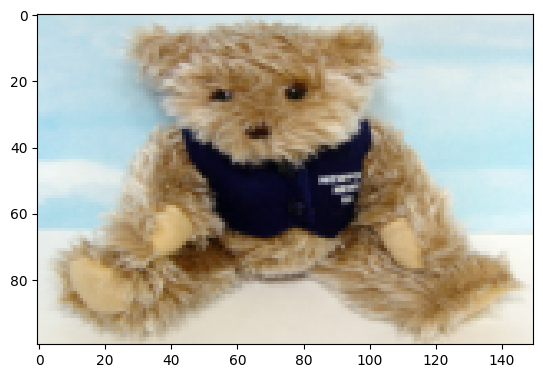

triceratops_0002.jpg


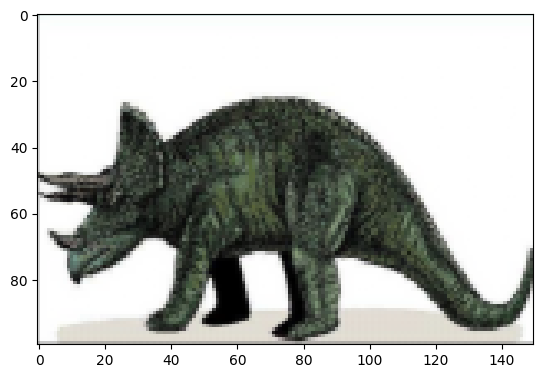

unicorn_0002.jpg


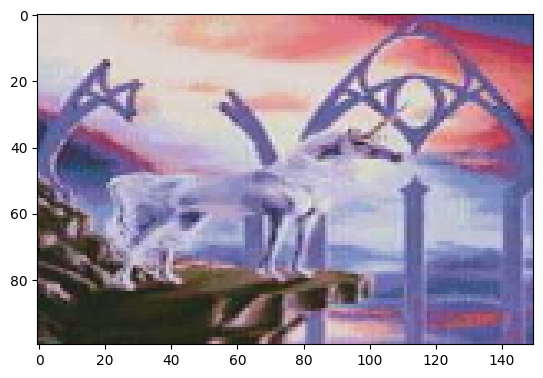

zebra_0002.jpg


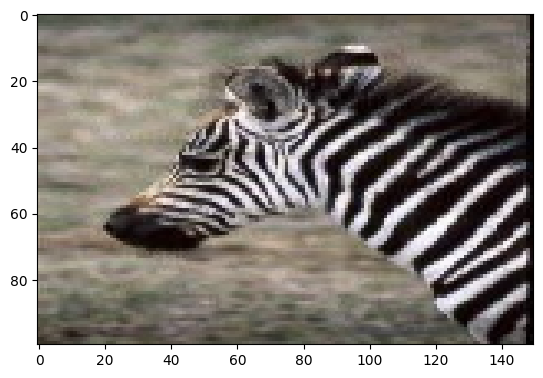

In [6]:
# loop to view the images in each category of training.
for file in categories:
    image = os.listdir(f"./20_train/20_categories_training/{file}")[1]
    print(image)
    image = plt.imread(f"./20_train/20_categories_training/{file}/{image}")
    resized_image = resize(image, (100,150))
    plt.imshow(resized_image)
    plt.show()

# HOG Images

airplanes_0002.jpg


C:\Users\yagni\anaconda3\envs\tensorflow_gpu\lib\site-packages\ipykernel_launcher.py:9: FutureWarning: `multichannel` is a deprecated argument name for `hog`. It will be removed in version 1.0. Please use `channel_axis` instead.
  if __name__ == "__main__":


<Figure size 500x500 with 0 Axes>

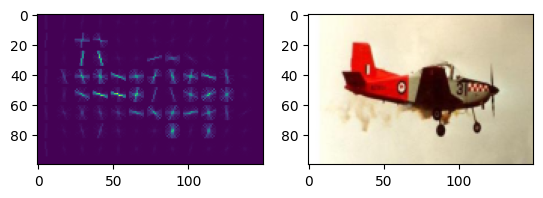

bear_0002.jpg


<Figure size 500x500 with 0 Axes>

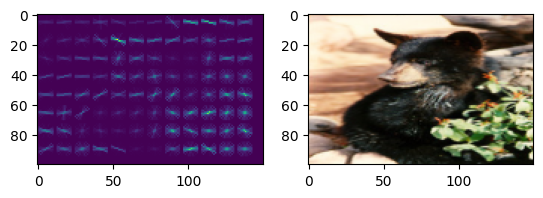

blimp_0002.jpg


<Figure size 500x500 with 0 Axes>

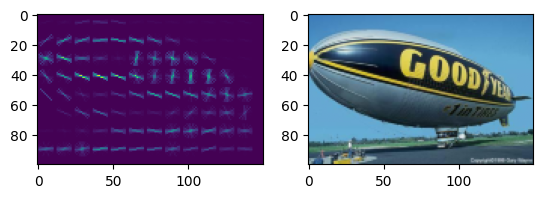

comet_0002.jpg


<Figure size 500x500 with 0 Axes>

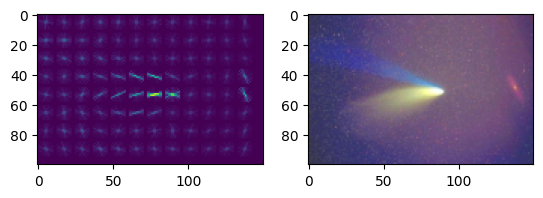

crab_0002.jpg


<Figure size 500x500 with 0 Axes>

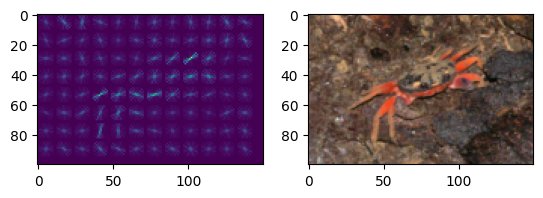

dog_0002.jpg


<Figure size 500x500 with 0 Axes>

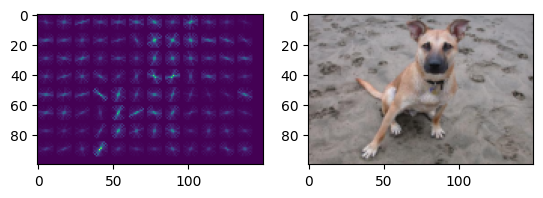

dolphin_0002.jpg


<Figure size 500x500 with 0 Axes>

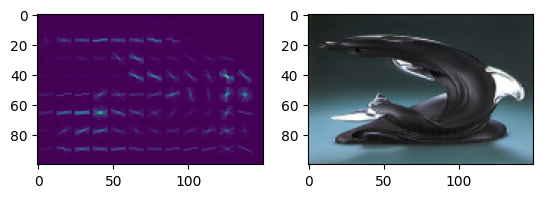

giraffe_0002.jpg


<Figure size 500x500 with 0 Axes>

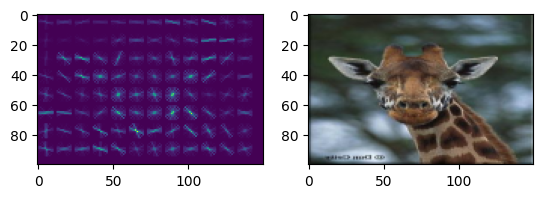

goat_0002.jpg


<Figure size 500x500 with 0 Axes>

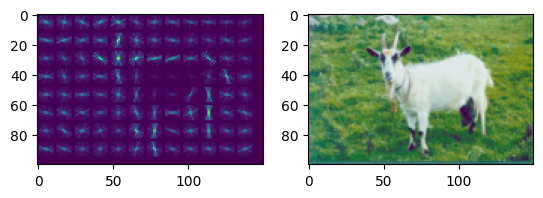

gorilla_0002.jpg


<Figure size 500x500 with 0 Axes>

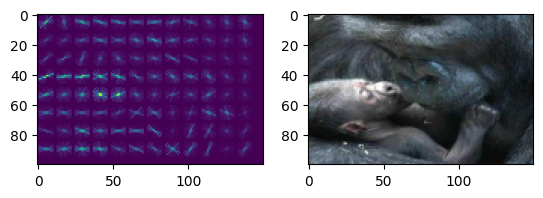

kangaroo_0002.jpg


<Figure size 500x500 with 0 Axes>

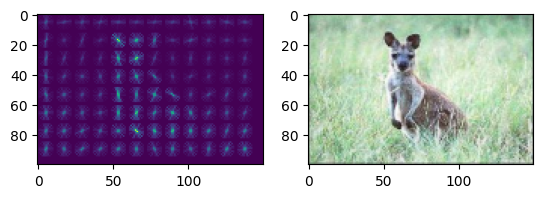

killer-whale_0002.jpg


<Figure size 500x500 with 0 Axes>

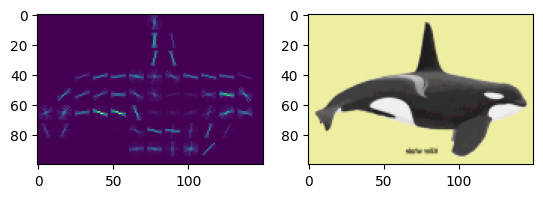

leopards_0002.jpg


<Figure size 500x500 with 0 Axes>

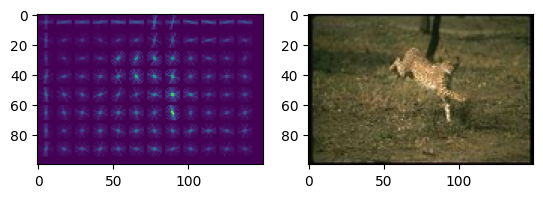

llama_0002.jpg


<Figure size 500x500 with 0 Axes>

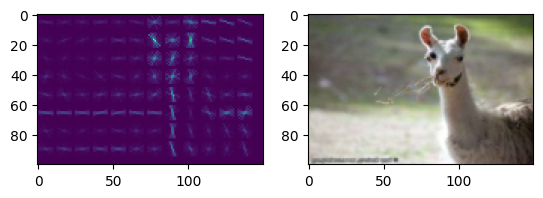

penguin_0002.jpg


<Figure size 500x500 with 0 Axes>

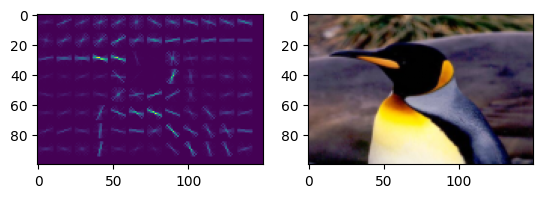

porcupine_0002.jpg


<Figure size 500x500 with 0 Axes>

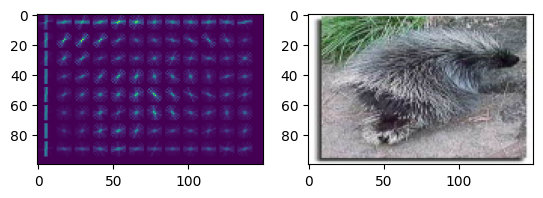

teddy-bear_0002.jpg


<Figure size 500x500 with 0 Axes>

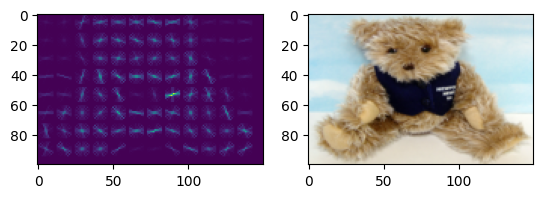

triceratops_0002.jpg


<Figure size 500x500 with 0 Axes>

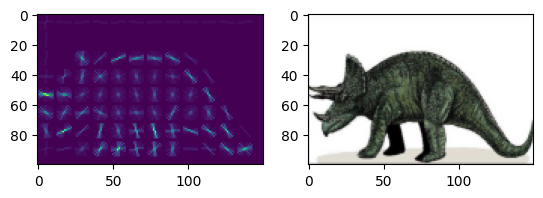

unicorn_0002.jpg


<Figure size 500x500 with 0 Axes>

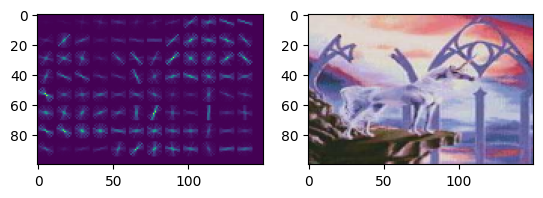

zebra_0002.jpg


<Figure size 500x500 with 0 Axes>

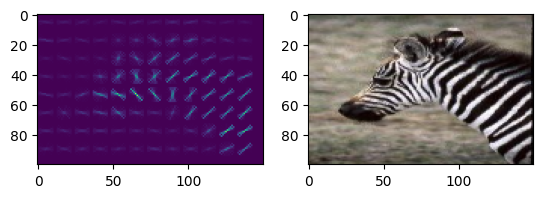

In [7]:
# loop to view the original images and histogram of gradient image side-by-side
for file in categories:
    plt.figure(figsize=(5,5))
    fig, ax = plt.subplots(1,2)
    image = os.listdir(f"./20_train/20_categories_training/{file}")[1]
    print(image)
    image = plt.imread(f"./20_train/20_categories_training/{file}/{image}")
    resized_image = resize(image, (100,150))
    fd, hog_image = hog(resized_image, orientations=30, pixels_per_cell=(12,12),
                   cells_per_block=(4,4), visualize=True, multichannel=True)
    ax[0].imshow(hog_image)
    ax[1].imshow(resized_image)
    plt.show()

# Extracting HOD features

In [8]:
# loop to extract histogram of gradients features
features = []
labels = []
for file in tqdm(categories):
    images = os.listdir(f"./20_train/20_categories_training/{file}")
    for image in images:
        image_file = image
        try:
            image = plt.imread(f"./20_train/20_categories_training/{file}/{image}")
            resized_image = resize(image, (100,150)) # resizing image
            fd, hog_image = hog(resized_image, orientations=20, pixels_per_cell=(6,6),
                   cells_per_block=(1,1), visualize=True, multichannel=True) # extracting hog features
            features.append(fd)
            labels.append(file)
        except:
            os.remove(f"./20_train/20_categories_training/{file}/{image_file}")
            print(f"{file} deleted")


  0%|                                                                                           | 0/20 [00:00<?, ?it/s]C:\Users\yagni\anaconda3\envs\tensorflow_gpu\lib\site-packages\ipykernel_launcher.py:11: FutureWarning: `multichannel` is a deprecated argument name for `hog`. It will be removed in version 1.0. Please use `channel_axis` instead.
  # This is added back by InteractiveShellApp.init_path()
100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [03:48<00:00, 11.40s/it]


In [9]:
# checking the shape of features extracted
np.array(features).shape

(1485, 8000)

In [10]:
# converting the features array into dataframe
data_frame = pd.DataFrame(features)

In [11]:
# adding labels to the data_frame
data_frame["labels"] = labels  

In [12]:
# making X and y variables
X = data_frame.drop("labels",axis=1)
y = data_frame.labels

In [13]:
# splitting data into train and test
x_train, x_test, y_train, y_test = train_test_split(X,y,test_size=0.2,stratify=y,shuffle=True)

# Logistic Regression

In [14]:
# initializing model for Logistic Regression with max_iter to be 1000
model = LogisticRegression(max_iter=1000)

In [15]:
# fitting the model with train data
model.fit(x_train,y_train)

LogisticRegression(max_iter=1000)

In [16]:
# getting train score
model.score(x_train,y_train)

1.0

In [17]:
# getting test score
model.score(x_test,y_test)

0.35353535353535354

In [18]:
# getting train predictions
train_preds = model.predict(x_train)

In [19]:
# getting test predictions
test_preds = model.predict(x_test)

In [20]:
# getting classification report
print(classification_report(y_train,train_preds))

              precision    recall  f1-score   support

   airplanes       1.00      1.00      1.00        64
        bear       1.00      1.00      1.00        54
       blimp       1.00      1.00      1.00        45
       comet       1.00      1.00      1.00        55
        crab       1.00      1.00      1.00        45
         dog       1.00      1.00      1.00        54
     dolphin       1.00      1.00      1.00        56
     giraffe       1.00      1.00      1.00        45
        goat       1.00      1.00      1.00        60
     gorilla       1.00      1.00      1.00       112
    kangaroo       1.00      1.00      1.00        44
killer-whale       1.00      1.00      1.00        49
    leopards       1.00      1.00      1.00       102
       llama       1.00      1.00      1.00        63
     penguin       1.00      1.00      1.00        79
   porcupine       1.00      1.00      1.00        54
  teddy-bear       1.00      1.00      1.00        54
 triceratops       1.00    

In [21]:
# getting test classification report
print(classification_report(y_test,test_preds))

              precision    recall  f1-score   support

   airplanes       1.00      0.94      0.97        16
        bear       0.00      0.00      0.00        14
       blimp       0.50      0.36      0.42        11
       comet       0.40      0.43      0.41        14
        crab       0.22      0.18      0.20        11
         dog       0.18      0.14      0.16        14
     dolphin       0.20      0.14      0.17        14
     giraffe       0.00      0.00      0.00        11
        goat       0.00      0.00      0.00        15
     gorilla       0.25      0.50      0.33        28
    kangaroo       0.50      0.36      0.42        11
killer-whale       0.14      0.25      0.18        12
    leopards       0.65      0.96      0.77        25
       llama       0.31      0.25      0.28        16
     penguin       0.21      0.30      0.25        20
   porcupine       0.18      0.15      0.17        13
  teddy-bear       0.38      0.38      0.38        13
 triceratops       0.45    

# Harris Corner 

  0%|                                                                                           | 0/20 [00:00<?, ?it/s]

<Figure size 500x500 with 0 Axes>

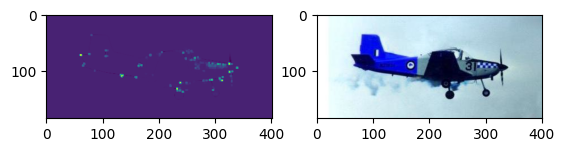

  5%|████▏                                                                              | 1/20 [00:00<00:03,  5.78it/s]

<Figure size 500x500 with 0 Axes>

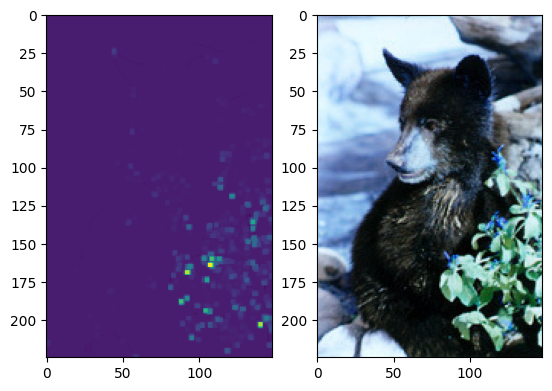

 10%|████████▎                                                                          | 2/20 [00:00<00:03,  5.04it/s]

<Figure size 500x500 with 0 Axes>

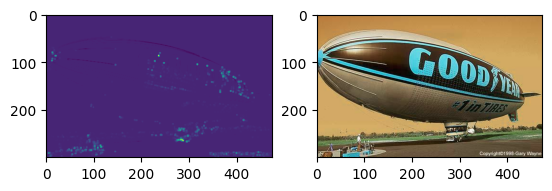

 15%|████████████▍                                                                      | 3/20 [00:00<00:03,  4.56it/s]

<Figure size 500x500 with 0 Axes>

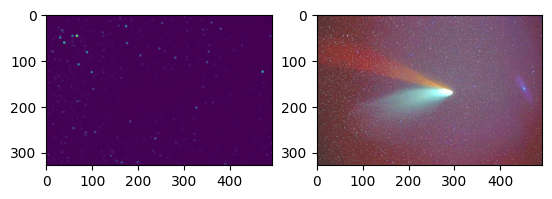

 20%|████████████████▌                                                                  | 4/20 [00:00<00:03,  4.65it/s]

<Figure size 500x500 with 0 Axes>

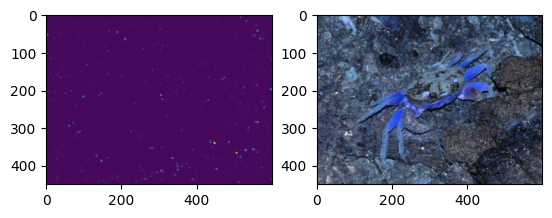

 25%|████████████████████▊                                                              | 5/20 [00:01<00:03,  4.57it/s]

<Figure size 500x500 with 0 Axes>

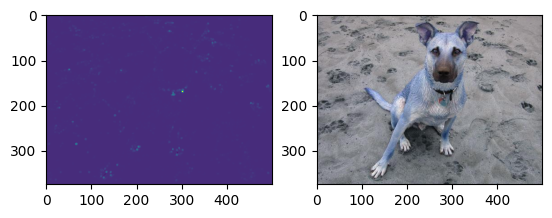

 30%|████████████████████████▉                                                          | 6/20 [00:01<00:02,  4.78it/s]

<Figure size 500x500 with 0 Axes>

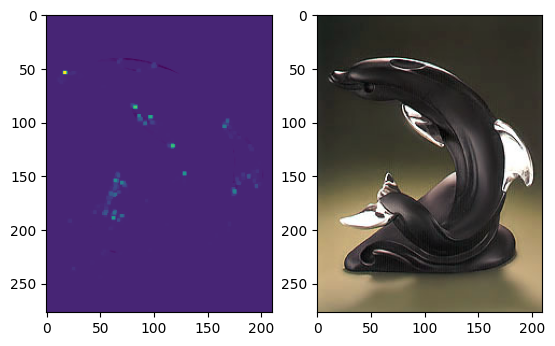

 35%|█████████████████████████████                                                      | 7/20 [00:01<00:02,  4.82it/s]

<Figure size 500x500 with 0 Axes>

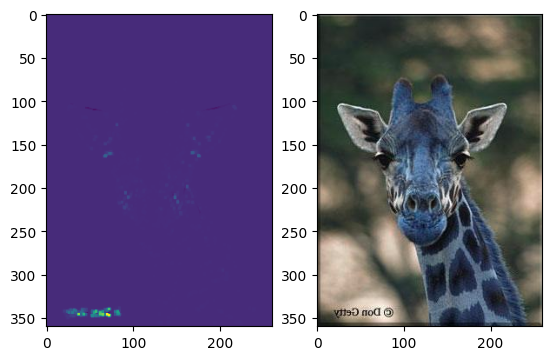

 40%|█████████████████████████████████▏                                                 | 8/20 [00:01<00:02,  4.67it/s]

<Figure size 500x500 with 0 Axes>

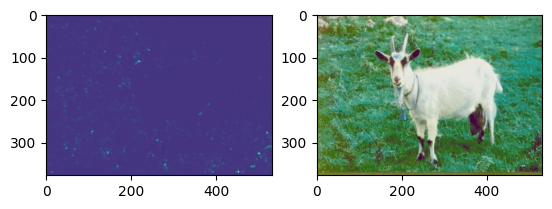

 45%|█████████████████████████████████████▎                                             | 9/20 [00:01<00:02,  4.84it/s]

<Figure size 500x500 with 0 Axes>

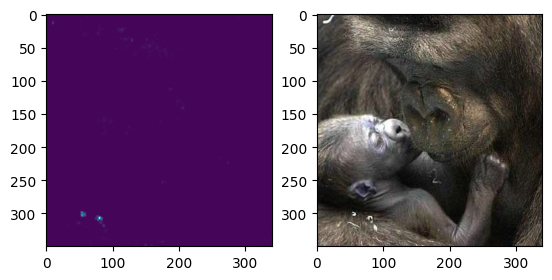

 50%|█████████████████████████████████████████                                         | 10/20 [00:02<00:02,  4.79it/s]

<Figure size 500x500 with 0 Axes>

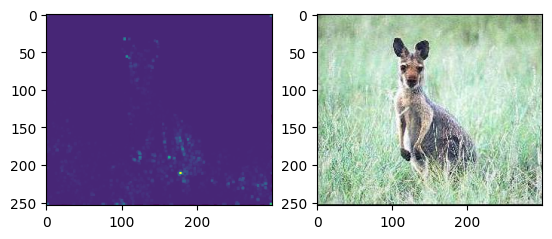

 55%|█████████████████████████████████████████████                                     | 11/20 [00:02<00:01,  4.87it/s]

<Figure size 500x500 with 0 Axes>

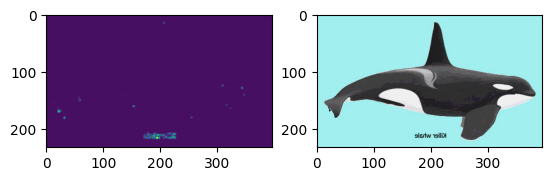

 60%|█████████████████████████████████████████████████▏                                | 12/20 [00:02<00:01,  4.64it/s]

<Figure size 500x500 with 0 Axes>

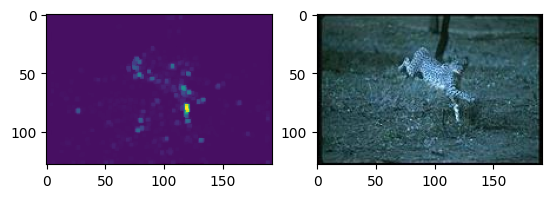

 65%|█████████████████████████████████████████████████████▎                            | 13/20 [00:02<00:01,  5.11it/s]

<Figure size 500x500 with 0 Axes>

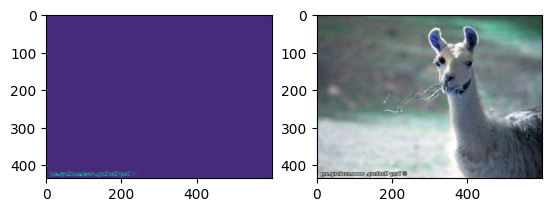

 70%|█████████████████████████████████████████████████████████▍                        | 14/20 [00:02<00:01,  4.75it/s]

<Figure size 500x500 with 0 Axes>

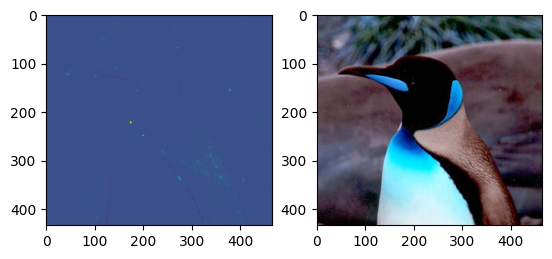

 75%|█████████████████████████████████████████████████████████████▌                    | 15/20 [00:03<00:01,  4.74it/s]

<Figure size 500x500 with 0 Axes>

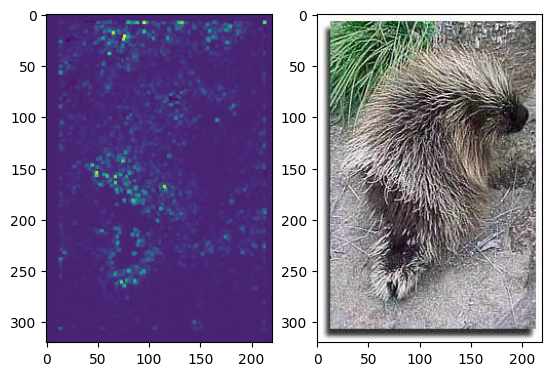

 80%|█████████████████████████████████████████████████████████████████▌                | 16/20 [00:03<00:00,  4.59it/s]

<Figure size 500x500 with 0 Axes>

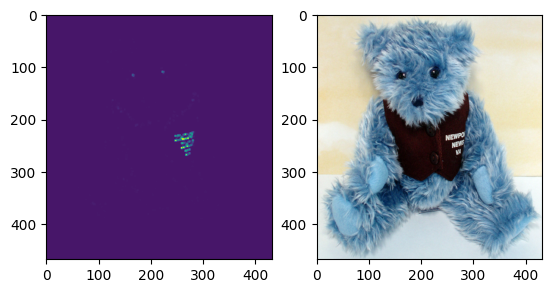

 85%|█████████████████████████████████████████████████████████████████████▋            | 17/20 [00:03<00:00,  4.61it/s]

<Figure size 500x500 with 0 Axes>

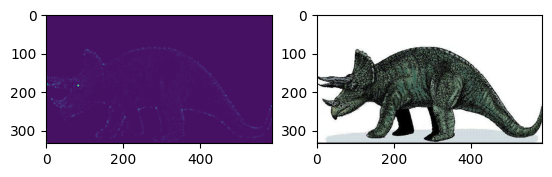

 90%|█████████████████████████████████████████████████████████████████████████▊        | 18/20 [00:03<00:00,  4.95it/s]

<Figure size 500x500 with 0 Axes>

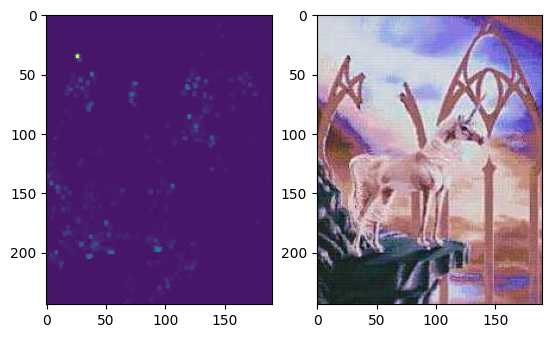

 95%|█████████████████████████████████████████████████████████████████████████████▉    | 19/20 [00:03<00:00,  5.04it/s]

<Figure size 500x500 with 0 Axes>

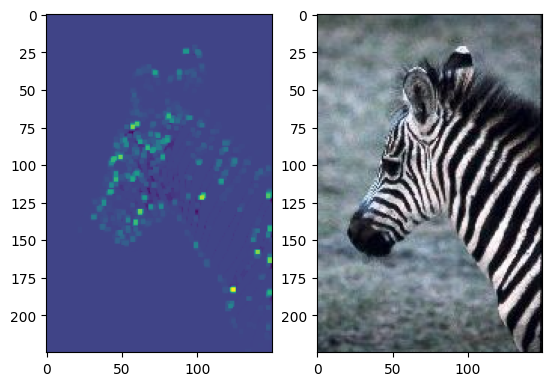

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.81it/s]


In [22]:
# loop for viewing harris corner features
features_harris = []
labels_harris = []
for file in tqdm(categories):
    image = os.listdir(f"./20_train/20_categories_training/{file}")[1]
    plt.figure(figsize=(5,5))
    fig, ax = plt.subplots(1,2)
    image = cv2.imread(f"./20_train/20_categories_training/{file}/{image}")
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) # converting the image to gray
    gray = np.float32(gray)
    dst = cv2.cornerHarris(gray, 2, 3, 0.04) # extracting harris features
    dst = cv2.dilate(dst,None) # dilating the features
    ax[0].imshow(dst)
    ax[1].imshow(image)
    plt.show()

In [23]:
# loop for extracting harris corner features
features_harris = []
labels_harris = []
for file in tqdm(categories):
    images = os.listdir(f"./20_train/20_categories_training/{file}")
    for image in images:
        try:
            image = cv2.imread(f"./20_train/20_categories_training/{file}/{image}") # reading image
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) # converting to gray
            gray = np.float32(gray) # converting to float
            dst = cv2.cornerHarris(gray, 2, 3, 0.04) # extracting harris corner
            dst = cv2.dilate(dst,None) # dilating image
            features_harris.append(dst) # saving features to list
            labels_harris.append(file) # saving labels to list
        except:
            continue

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [00:09<00:00,  2.20it/s]


# BRISK based feature Extraction

In [24]:
# initializing brisk
source = cv2.BRISK_create()

  0%|                                                                                           | 0/20 [00:00<?, ?it/s]

<Figure size 500x500 with 0 Axes>

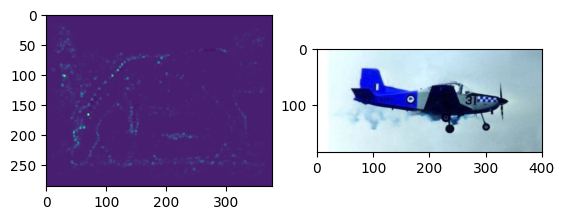

  5%|████▏                                                                              | 1/20 [00:00<00:04,  4.63it/s]

<Figure size 500x500 with 0 Axes>

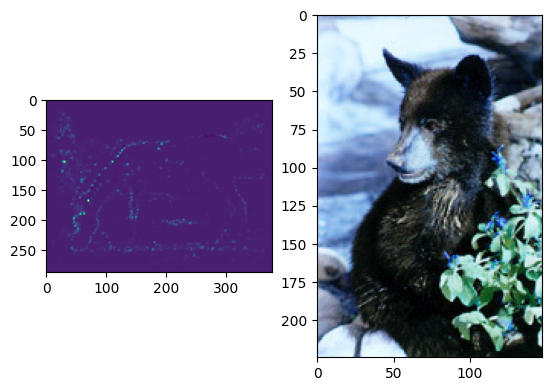

 10%|████████▎                                                                          | 2/20 [00:00<00:04,  4.21it/s]

<Figure size 500x500 with 0 Axes>

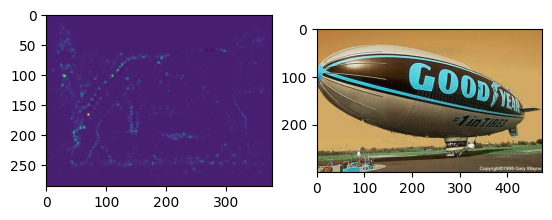

 15%|████████████▍                                                                      | 3/20 [00:00<00:04,  4.24it/s]

<Figure size 500x500 with 0 Axes>

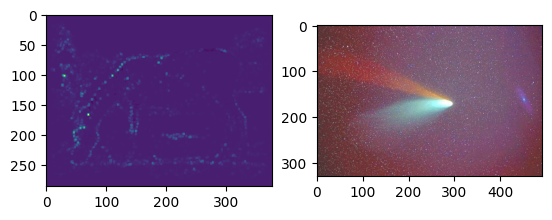

 20%|████████████████▌                                                                  | 4/20 [00:00<00:03,  4.26it/s]

<Figure size 500x500 with 0 Axes>

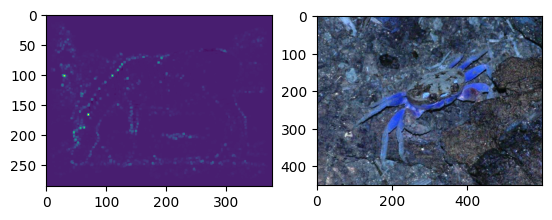

 25%|████████████████████▊                                                              | 5/20 [00:01<00:03,  3.94it/s]

<Figure size 500x500 with 0 Axes>

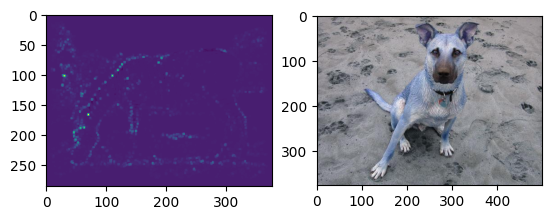

 30%|████████████████████████▉                                                          | 6/20 [00:01<00:03,  3.51it/s]

<Figure size 500x500 with 0 Axes>

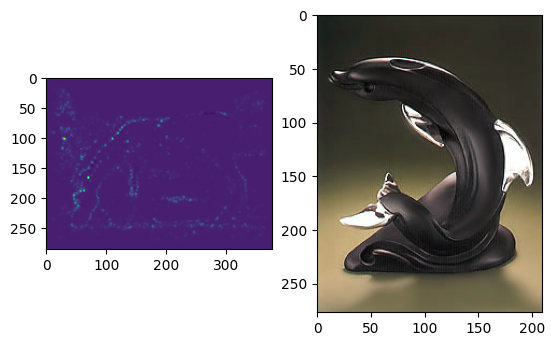

 35%|█████████████████████████████                                                      | 7/20 [00:01<00:03,  3.90it/s]

<Figure size 500x500 with 0 Axes>

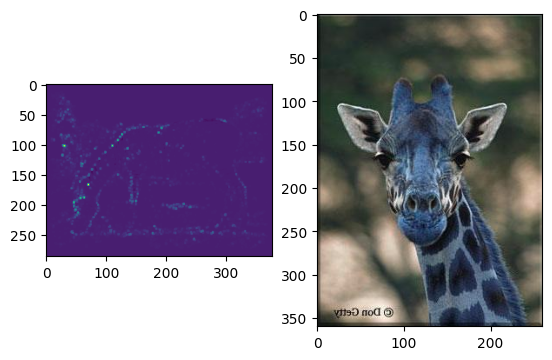

 40%|█████████████████████████████████▏                                                 | 8/20 [00:01<00:02,  4.02it/s]

<Figure size 500x500 with 0 Axes>

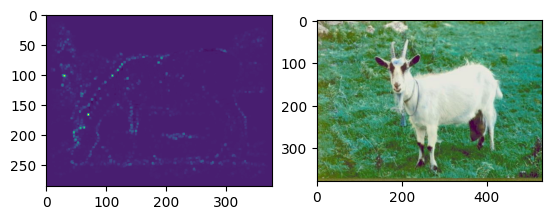

 45%|█████████████████████████████████████▎                                             | 9/20 [00:02<00:02,  4.00it/s]

<Figure size 500x500 with 0 Axes>

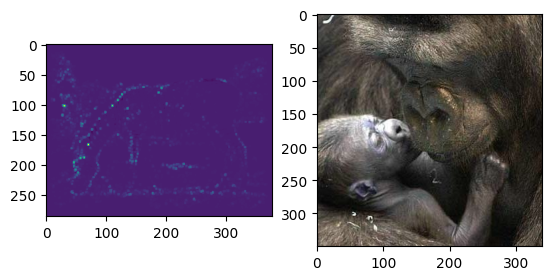

 50%|█████████████████████████████████████████                                         | 10/20 [00:02<00:02,  4.19it/s]

<Figure size 500x500 with 0 Axes>

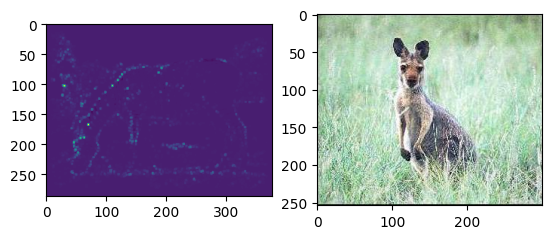

 55%|█████████████████████████████████████████████                                     | 11/20 [00:02<00:02,  4.26it/s]

<Figure size 500x500 with 0 Axes>

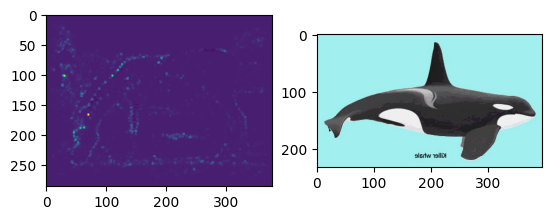

 60%|█████████████████████████████████████████████████▏                                | 12/20 [00:02<00:01,  4.62it/s]

<Figure size 500x500 with 0 Axes>

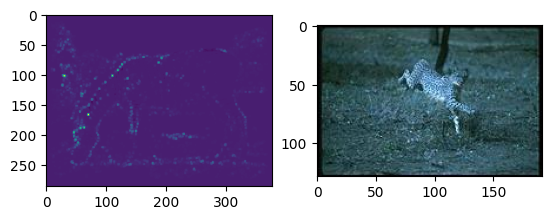

 65%|█████████████████████████████████████████████████████▎                            | 13/20 [00:03<00:01,  4.89it/s]

<Figure size 500x500 with 0 Axes>

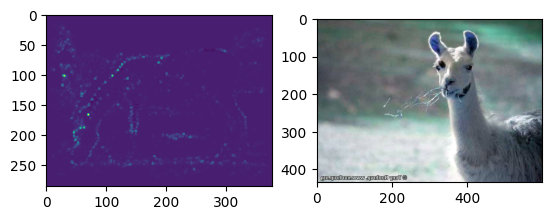

 70%|█████████████████████████████████████████████████████████▍                        | 14/20 [00:03<00:01,  4.82it/s]

<Figure size 500x500 with 0 Axes>

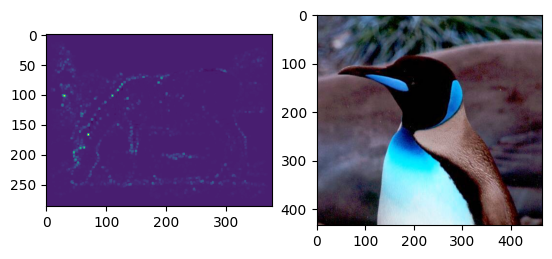

 75%|█████████████████████████████████████████████████████████████▌                    | 15/20 [00:03<00:01,  4.81it/s]

<Figure size 500x500 with 0 Axes>

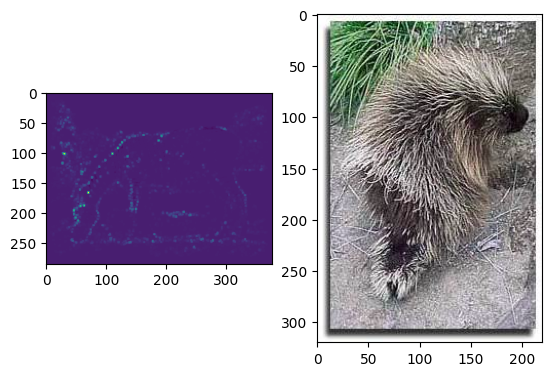

 80%|█████████████████████████████████████████████████████████████████▌                | 16/20 [00:03<00:00,  4.47it/s]

<Figure size 500x500 with 0 Axes>

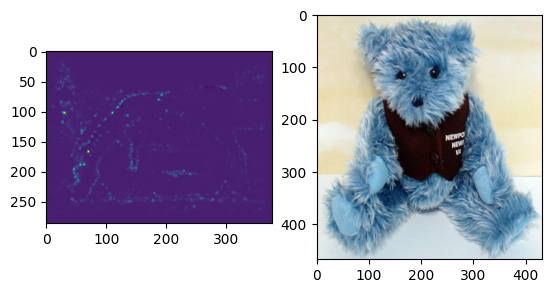

 85%|█████████████████████████████████████████████████████████████████████▋            | 17/20 [00:03<00:00,  4.41it/s]

<Figure size 500x500 with 0 Axes>

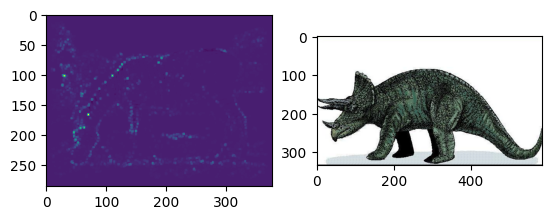

 90%|█████████████████████████████████████████████████████████████████████████▊        | 18/20 [00:04<00:00,  4.18it/s]

<Figure size 500x500 with 0 Axes>

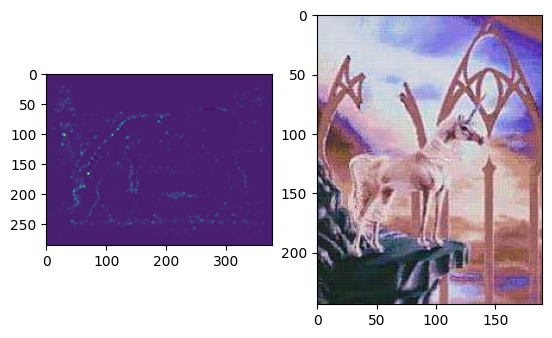

 95%|█████████████████████████████████████████████████████████████████████████████▉    | 19/20 [00:04<00:00,  4.31it/s]

<Figure size 500x500 with 0 Axes>

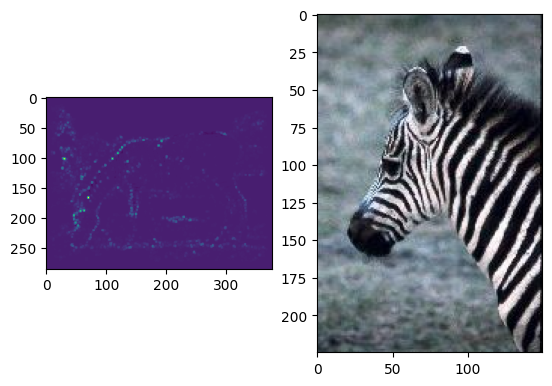

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.17it/s]


In [25]:
#loop to view brisk features
for file in tqdm(categories):
    image = os.listdir(f"./20_train/20_categories_training/{file}")[1]
    plt.figure(figsize=(5,5))
    fig, ax = plt.subplots(1,2)
    image = cv2.imread(f"./20_train/20_categories_training/{file}/{image}")
    kp, des = source.detectAndCompute(image, None) # getting brisk features
    imgKP = cv2.drawKeypoints(image, kp, None, color=(0,255,0), flags=0) # drawing key points to brisk features
    ax[0].imshow(dst)
    ax[1].imshow(image)
    plt.show()

In [26]:
# loop to extract brisk features
features_brisk = []
labels_brisk = []
for file in tqdm(categories):
    images = os.listdir(f"./20_train/20_categories_training/{file}")
    for image in images:
        try:
            image = cv2.imread(f"./20_train/20_categories_training/{file}/{image}") # reading image
            kp, des = source.detectAndCompute(image, None) # brisk feature extraction
            imgKP = cv2.drawKeypoints(image, kp, None, color=(0,255,0), flags=0) # draw keypoints
            features_brisk.append(kp) # appending features to list
            labels_brisk.append(file) # appending label name to list
        except:
            continue

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [00:56<00:00,  2.81s/it]


# CNN Based feature Extraction

In [27]:
#initializing tensorflow
from tensorflow.keras.applications.vgg16 import VGG16

In [28]:
# initializing vgg model
model = VGG16()

Instructions for updating:
If using Keras pass *_constraint arguments to layers.


In [29]:
# getting summary of model
model.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

In [30]:
# getting the each layer information 
for layer in model.layers:
 # check for convolutional layer
 if 'conv' not in layer.name:
     continue
 # get filter weights
 filters, biases = layer.get_weights()
 print(layer.name, filters.shape)

block1_conv1 (3, 3, 3, 64)
block1_conv2 (3, 3, 64, 64)
block2_conv1 (3, 3, 64, 128)
block2_conv2 (3, 3, 128, 128)
block3_conv1 (3, 3, 128, 256)
block3_conv2 (3, 3, 256, 256)
block3_conv3 (3, 3, 256, 256)
block4_conv1 (3, 3, 256, 512)
block4_conv2 (3, 3, 512, 512)
block4_conv3 (3, 3, 512, 512)
block5_conv1 (3, 3, 512, 512)
block5_conv2 (3, 3, 512, 512)
block5_conv3 (3, 3, 512, 512)


In [31]:
# extracting filters and biases
filters, biases = model.layers[1].get_weights()

In [32]:

# normalize filter values to 0-1 so we can visualize them
f_min, f_max = filters.min(), filters.max()
filters = (filters - f_min) / (f_max - f_min)

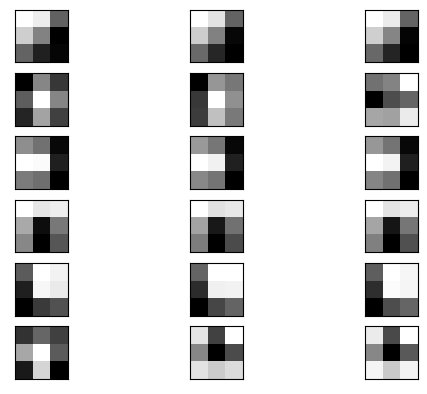

In [33]:

# plot first few filters
n_filters, ix = 6, 1
for i in range(n_filters):
 # get the filter
    f = filters[:, :, :, i]
    # plot each channel separately
    for j in range(3):
    # specify subplot and turn of axis
        ax = plt.subplot(n_filters, 3, ix)
        ax.set_xticks([])
        ax.set_yticks([])
        # plot filter channel in grayscale
        plt.imshow(f[:, :, j], cmap='gray')
        ix += 1
# show the figure
plt.show()

In [34]:
# Extracting model contents
model = Model(inputs=model.inputs, outputs=model.layers[1].output)

In [35]:
# plot feature map of first conv layer for given image
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array
from numpy import expand_dims

  0%|                                                                                           | 0/20 [00:00<?, ?it/s]

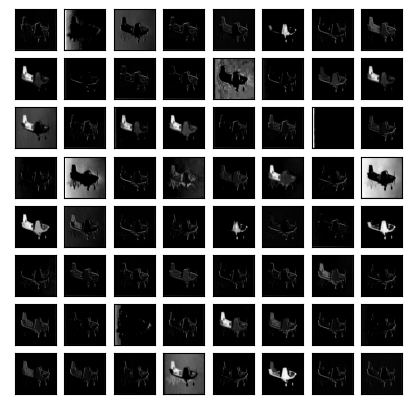

  5%|████▏                                                                              | 1/20 [00:04<01:20,  4.22s/it]

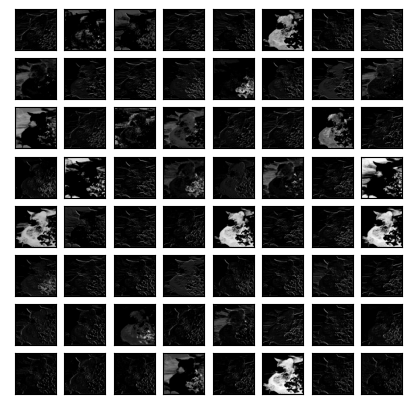

 10%|████████▎                                                                          | 2/20 [00:06<00:52,  2.94s/it]

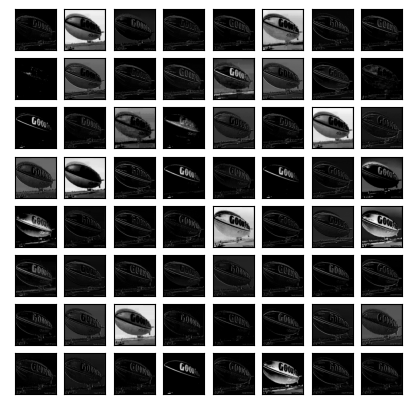

 15%|████████████▍                                                                      | 3/20 [00:08<00:42,  2.51s/it]

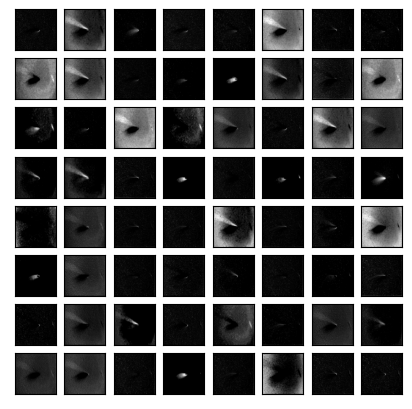

 20%|████████████████▌                                                                  | 4/20 [00:10<00:37,  2.34s/it]

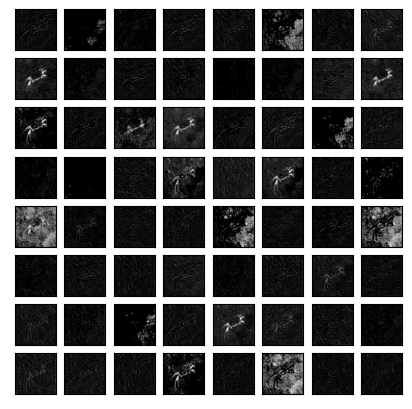

 25%|████████████████████▊                                                              | 5/20 [00:12<00:33,  2.21s/it]

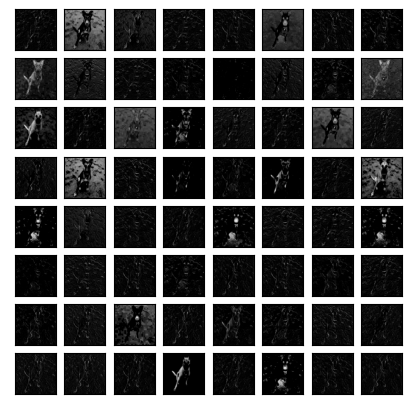

 30%|████████████████████████▉                                                          | 6/20 [00:14<00:29,  2.13s/it]

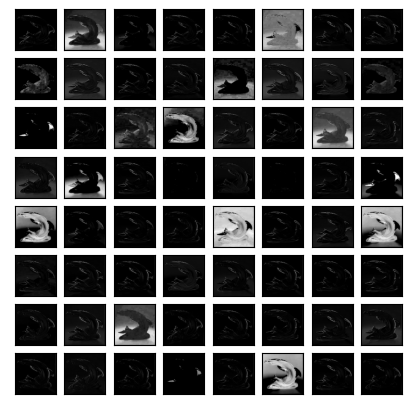

 35%|█████████████████████████████                                                      | 7/20 [00:16<00:27,  2.08s/it]

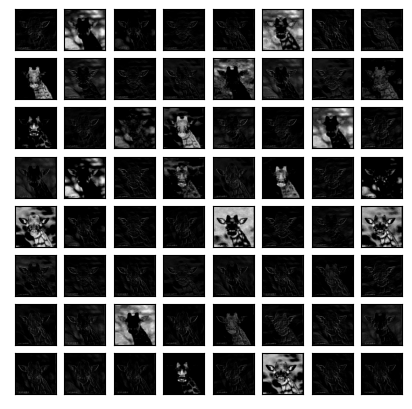

 40%|█████████████████████████████████▏                                                 | 8/20 [00:18<00:24,  2.05s/it]

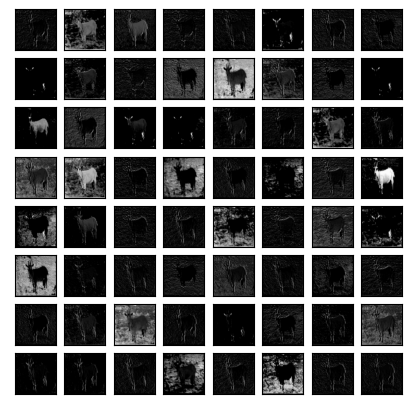

 45%|█████████████████████████████████████▎                                             | 9/20 [00:20<00:22,  2.05s/it]

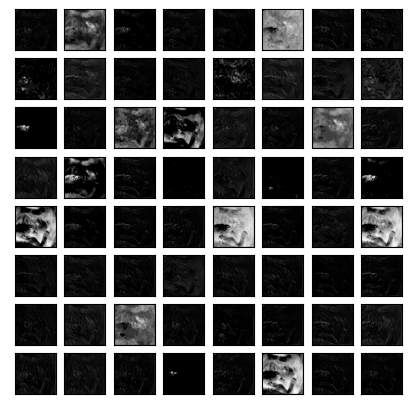

 50%|█████████████████████████████████████████                                         | 10/20 [00:22<00:20,  2.05s/it]

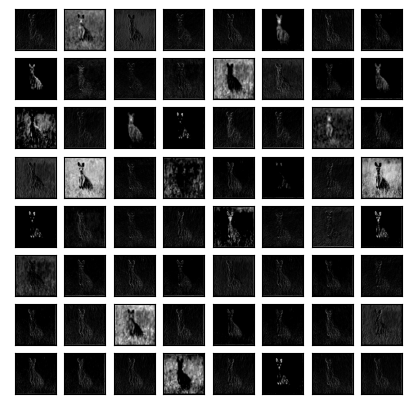

 55%|█████████████████████████████████████████████                                     | 11/20 [00:24<00:18,  2.04s/it]

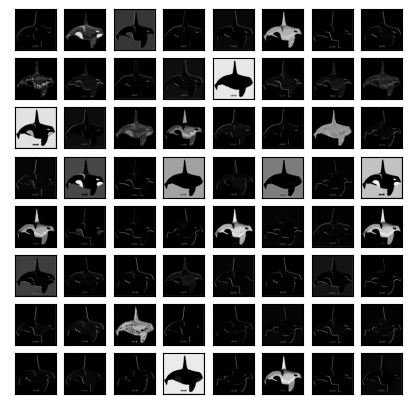

 60%|█████████████████████████████████████████████████▏                                | 12/20 [00:26<00:16,  2.04s/it]

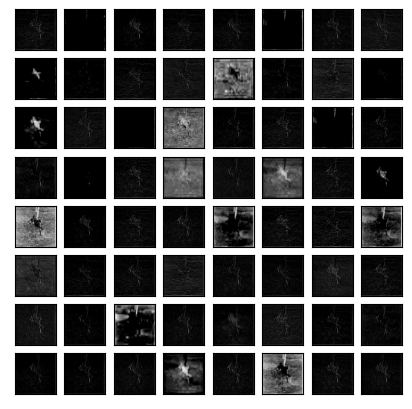

 65%|█████████████████████████████████████████████████████▎                            | 13/20 [00:28<00:14,  2.03s/it]

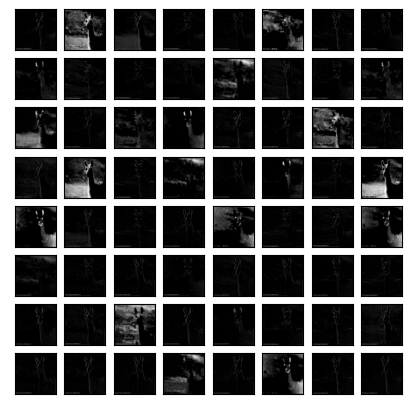

 70%|█████████████████████████████████████████████████████████▍                        | 14/20 [00:30<00:12,  2.02s/it]

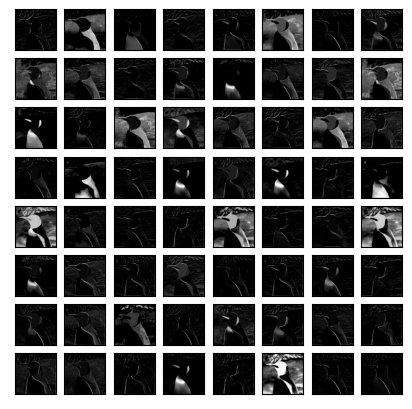

 75%|█████████████████████████████████████████████████████████████▌                    | 15/20 [00:32<00:10,  2.01s/it]

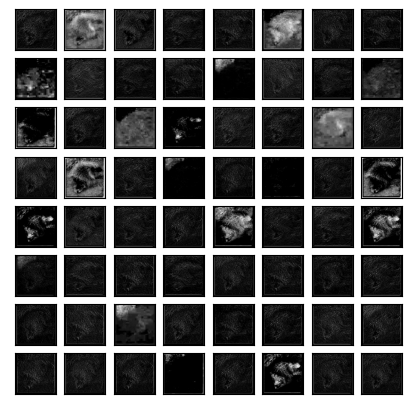

 80%|█████████████████████████████████████████████████████████████████▌                | 16/20 [00:34<00:08,  2.01s/it]

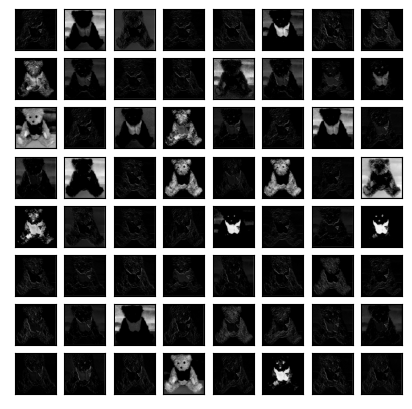

 85%|█████████████████████████████████████████████████████████████████████▋            | 17/20 [00:36<00:06,  2.02s/it]

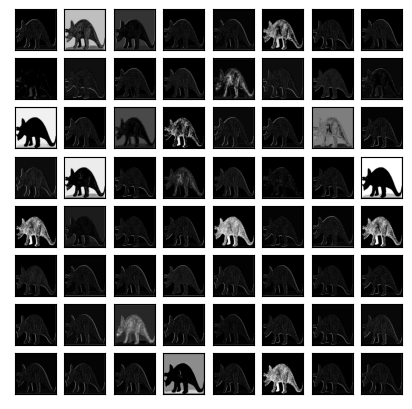

 90%|█████████████████████████████████████████████████████████████████████████▊        | 18/20 [00:38<00:04,  2.03s/it]

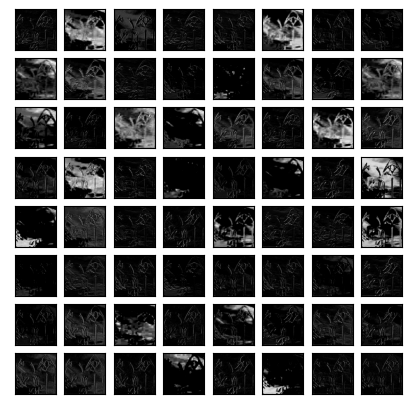

 95%|█████████████████████████████████████████████████████████████████████████████▉    | 19/20 [00:40<00:02,  2.02s/it]

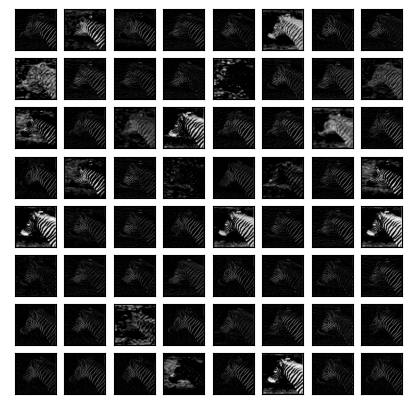

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [00:42<00:00,  2.13s/it]


In [36]:
# loop to view the convolution features for one image in all image categories
features = []
labels = []
for file in tqdm(categories):
    image = os.listdir(f"./20_train/20_categories_training/{file}")[1]
    plt.figure(figsize=(5,5))
    image = load_img(f'./20_train/20_categories_training/{file}/{image}', target_size=(224, 224))
    image = img_to_array(image)
    image = expand_dims(image, axis=0)
    image = preprocess_input(image)
    feature_maps = model.predict(image)
    square = 8
    ix = 1
    for _ in range(square):
        for _ in range(square):

            ax = plt.subplot(square, square, ix)
            ax.set_xticks([])
            ax.set_yticks([])
            plt.imshow(feature_maps[0, :, :, ix-1], cmap='gray')
            ix += 1
    # show the figure
    plt.show()

In [37]:
# loop to extract features of convolution using vgg16
features_cnn = []
labels_cnn = []
for file in tqdm(categories):
    images = os.listdir(f"./20_train/20_categories_training/{file}")
    for image in images:
        try:
        
            image = load_img(f'./20_train/20_categories_training/{file}/{image}', target_size=(224, 224))
            image = img_to_array(image)
            image = expand_dims(image, axis=0)
            image = preprocess_input(image)
            feature_maps = model.predict(image)
            features_cnn.append(feature_maps)
            labels_cnn.append(file)
        except:
            continue
    


100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [01:37<00:00,  4.85s/it]


# Visualizing Features Using PCA

In [38]:
#loading libraries
from sklearn.decomposition import PCA
import seaborn as sns

In [39]:
# initlaizing PCA with 10 components
pca = PCA(10)

In [40]:
# fitting pca with the hog features
pca.fit(X)

PCA(n_components=10)

In [41]:
# making a dataframe of components
pca_df = pd.DataFrame(pca.transform(X))

In [42]:
# adding labels tothe components
pca_df["labels"] = data_frame.labels

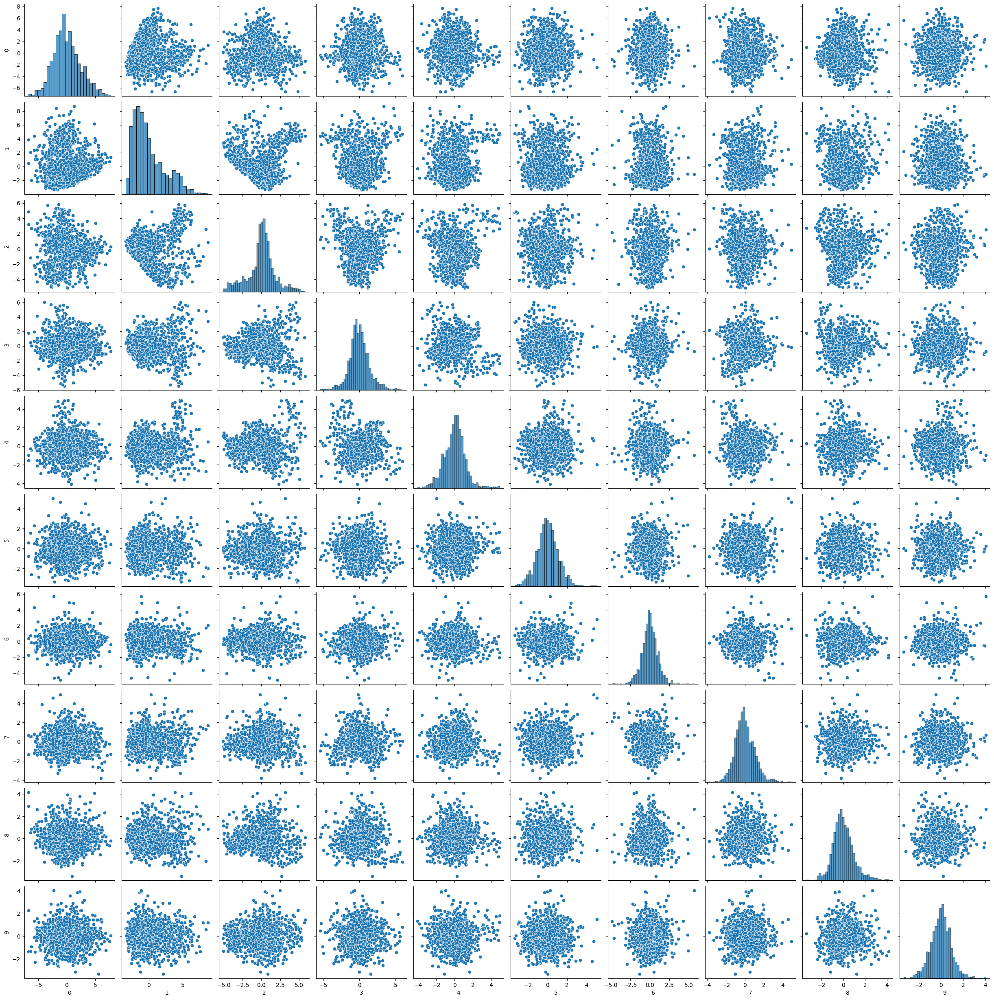

In [43]:
# plotting a pairplot for the components
sns.pairplot(pca_df.iloc[:,:-1])


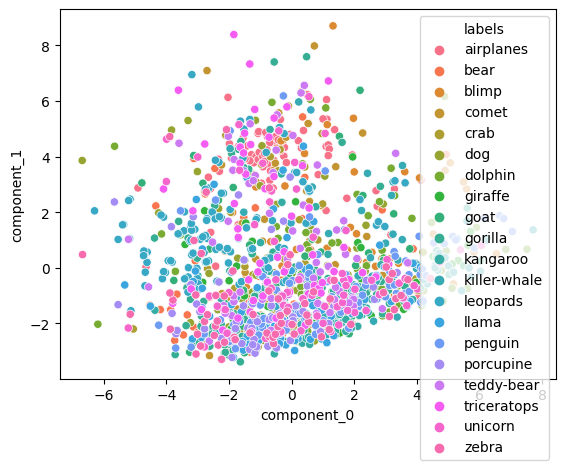

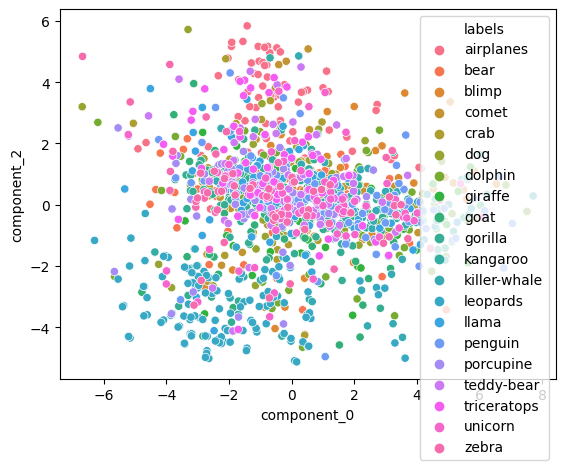

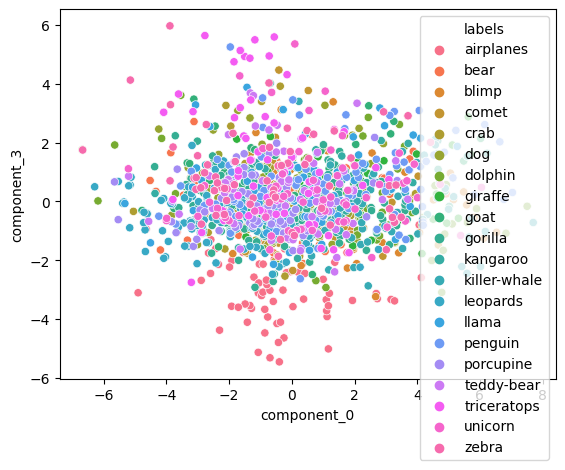

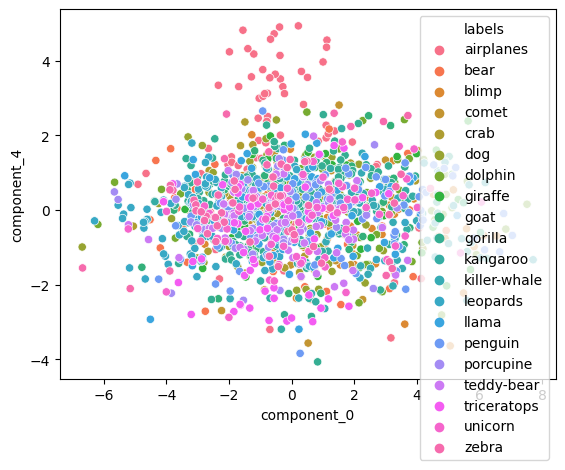

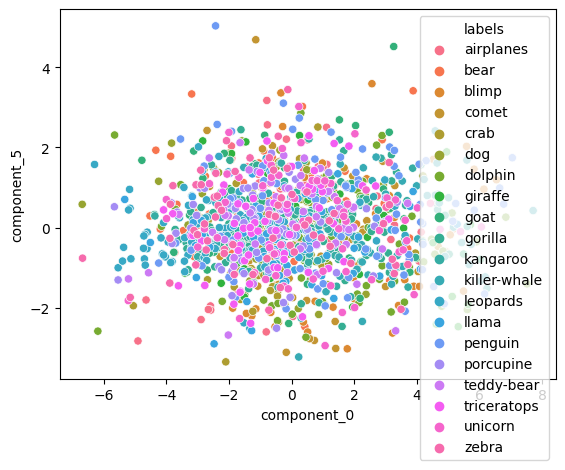

...

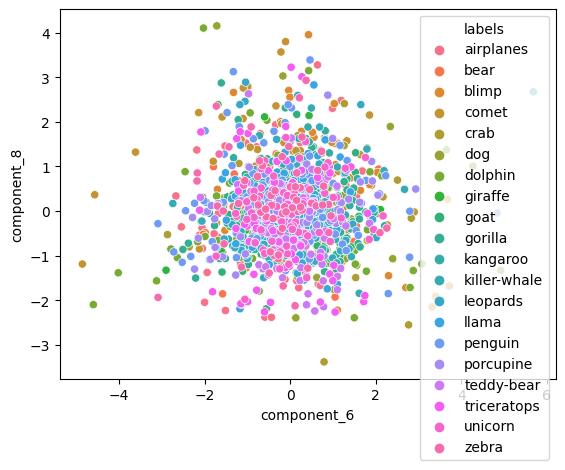

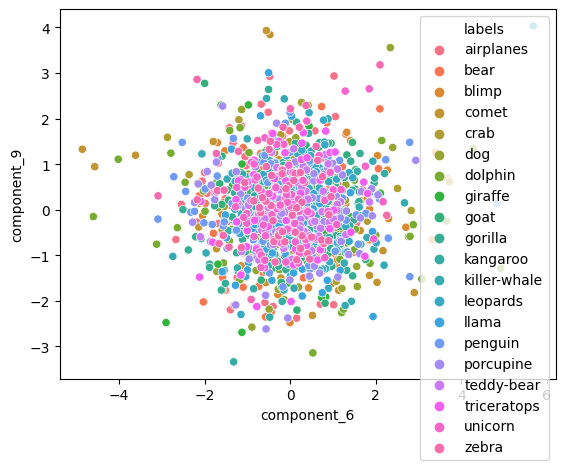

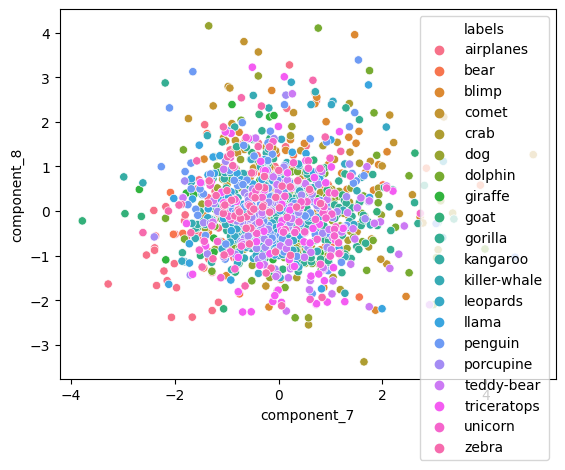

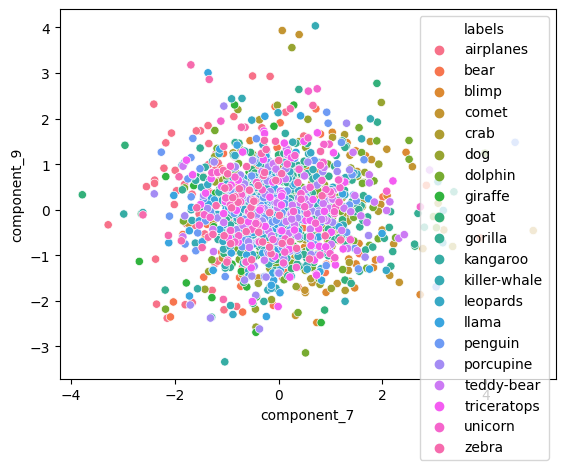

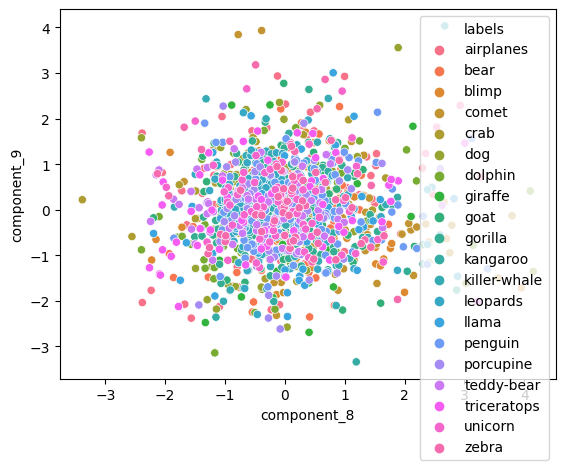

In [44]:
# plotting between the components using hue as labels
for i in range(10):
    for j in range(i,10):
        if i==j:
            continue
        sns.scatterplot(x = pca_df.iloc[:,i],y=pca_df.iloc[:,j], hue = pca_df.labels)
        plt.xlabel(f"component_{i}")
        plt.ylabel(f"component_{j}")
        plt.show()

# Visualization using t-SNE


In [45]:
# loading libraries
from sklearn.manifold import TSNE

In [46]:
# initialzing tsne with 3 components
tsne = TSNE(random_state = 42, n_components=3,verbose=0, perplexity=40, n_iter=400).fit_transform(pca_df.iloc[:,:-1])

C:\Users\yagni\anaconda3\envs\tensorflow_gpu\lib\site-packages\sklearn\manifold\_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
C:\Users\yagni\anaconda3\envs\tensorflow_gpu\lib\site-packages\sklearn\manifold\_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


In [47]:
# turning tsne components into a dataframe
tsne_df = pd.DataFrame(tsne)

In [48]:
# storing tsne labels in a dataframe
tsne_df["labels"] = data_frame.labels

In [49]:
# viewing tsne df
tsne_df

,0,1,2,labels
0,7.075514,-3.735095,-6.660135,airplanes
1,-5.251897,-7.312694,3.429656,airplanes
2,10.614188,-3.812365,-7.810765,airplanes
3,7.884452,-2.248127,-4.358996,airplanes
4,8.011602,-2.533478,-6.601535,airplanes
...,...,...,...,...
1480,-8.553969,0.038560,6.001289,zebra
1481,-10.766397,-0.760859,4.300209,zebra
1482,-5.115295,7.738762,1.412697,zebra
1483,-4.148889,-7.505376,-3.730373,zebra


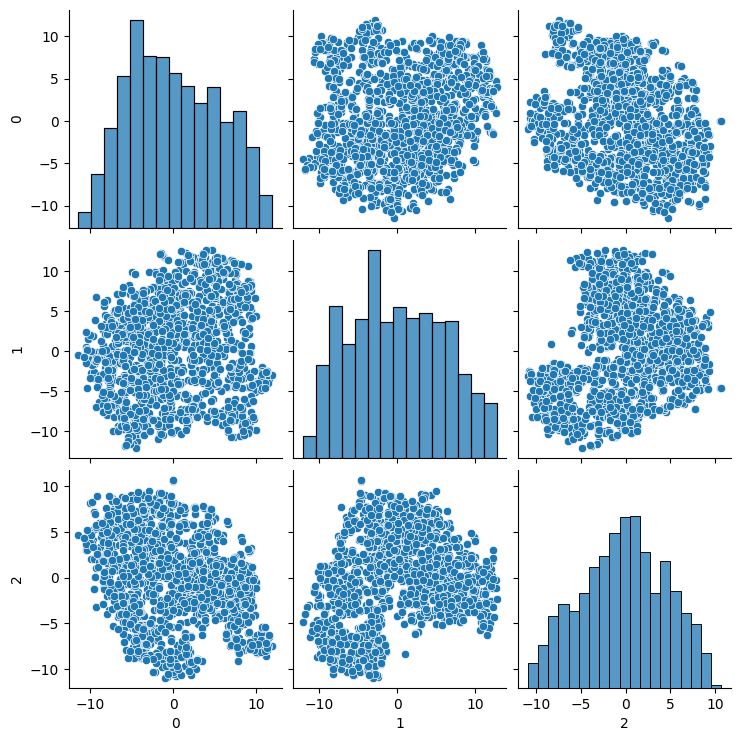

In [50]:
# plotting a pairplot for tsne dataframe
sns.pairplot(tsne_df.iloc[:,:-1])

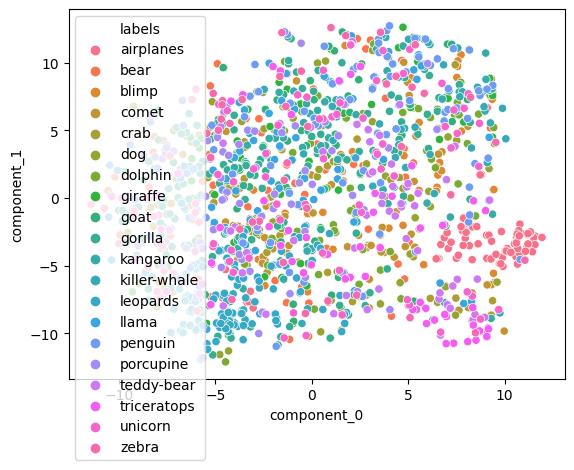

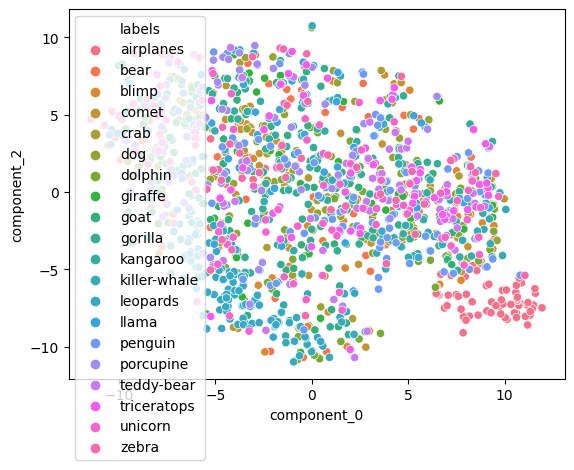

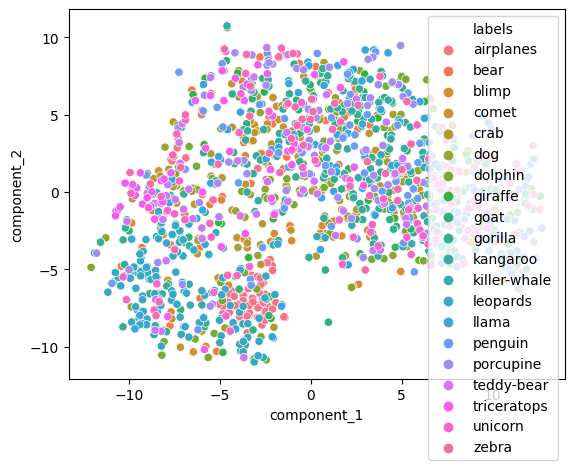

In [51]:
# plotting between components using hue as labels
for i in range(3):
    for j in range(i,3):
        if i==j:
            continue
        sns.scatterplot(x = tsne_df.iloc[:,i],y=tsne_df.iloc[:,j], hue = tsne_df.labels)
        plt.xlabel(f"component_{i}")
        plt.ylabel(f"component_{j}")
        plt.show()

# Classification using Logistic Regression on HOD Features

In [52]:
# intializing logistic regression model with 1000 max iterations
model = LogisticRegression(max_iter=1000)

In [53]:
# fitting on train
model.fit(x_train,y_train)

LogisticRegression(max_iter=1000)

In [54]:
#score on train
model.score(x_train,y_train)

1.0

In [55]:
# score on test
model.score(x_test,y_test)

0.35353535353535354

In [56]:
# predictions for train
train_preds = model.predict(x_train)

In [57]:
# predictions for test
test_preds = model.predict(x_test)

In [58]:
# classification report train
print(classification_report(y_train,train_preds))

              precision    recall  f1-score   support

   airplanes       1.00      1.00      1.00        64
        bear       1.00      1.00      1.00        54
       blimp       1.00      1.00      1.00        45
       comet       1.00      1.00      1.00        55
        crab       1.00      1.00      1.00        45
         dog       1.00      1.00      1.00        54
     dolphin       1.00      1.00      1.00        56
     giraffe       1.00      1.00      1.00        45
        goat       1.00      1.00      1.00        60
     gorilla       1.00      1.00      1.00       112
    kangaroo       1.00      1.00      1.00        44
killer-whale       1.00      1.00      1.00        49
    leopards       1.00      1.00      1.00       102
       llama       1.00      1.00      1.00        63
     penguin       1.00      1.00      1.00        79
   porcupine       1.00      1.00      1.00        54
  teddy-bear       1.00      1.00      1.00        54
 triceratops       1.00    

In [59]:
# classification report test
print(classification_report(y_test,test_preds))

              precision    recall  f1-score   support

   airplanes       1.00      0.94      0.97        16
        bear       0.00      0.00      0.00        14
       blimp       0.50      0.36      0.42        11
       comet       0.40      0.43      0.41        14
        crab       0.22      0.18      0.20        11
         dog       0.18      0.14      0.16        14
     dolphin       0.20      0.14      0.17        14
     giraffe       0.00      0.00      0.00        11
        goat       0.00      0.00      0.00        15
     gorilla       0.25      0.50      0.33        28
    kangaroo       0.50      0.36      0.42        11
killer-whale       0.14      0.25      0.18        12
    leopards       0.65      0.96      0.77        25
       llama       0.31      0.25      0.28        16
     penguin       0.21      0.30      0.25        20
   porcupine       0.18      0.15      0.17        13
  teddy-bear       0.38      0.38      0.38        13
 triceratops       0.45    

# SVM using HOD Features

In [60]:
# loading libraries
from sklearn.svm import SVC

In [104]:
# initialzing SVM with rbf kernel and max iter of 1000
model = SVC(max_iter=1000,kernel="rbf")

In [105]:
# fitting on train
model.fit(x_train,y_train)

SVC(max_iter=1000)

In [106]:
# scoring on train
model.score(x_train,y_train)

0.9873737373737373

In [107]:
#scoring on test
model.score(x_test,y_test)

0.27946127946127947

In [108]:
# prediction on train
train_preds = model.predict(x_train)

In [109]:
# prediction on test
test_preds = model.predict(x_test)

In [110]:
# classification report on train
print(classification_report(y_train,train_preds))

              precision    recall  f1-score   support

   airplanes       1.00      1.00      1.00        64
        bear       1.00      0.98      0.99        54
       blimp       1.00      1.00      1.00        45
       comet       1.00      1.00      1.00        55
        crab       1.00      0.96      0.98        45
         dog       1.00      1.00      1.00        54
     dolphin       1.00      0.98      0.99        56
     giraffe       1.00      1.00      1.00        45
        goat       1.00      1.00      1.00        60
     gorilla       0.92      1.00      0.96       112
    kangaroo       1.00      0.93      0.96        44
killer-whale       1.00      0.98      0.99        49
    leopards       0.95      1.00      0.98       102
       llama       1.00      1.00      1.00        63
     penguin       1.00      0.99      0.99        79
   porcupine       1.00      0.96      0.98        54
  teddy-bear       1.00      1.00      1.00        54
 triceratops       1.00    

In [111]:
# classifcation report on test
print(classification_report(y_test,test_preds))

              precision    recall  f1-score   support

   airplanes       1.00      0.94      0.97        16
        bear       0.00      0.00      0.00        14
       blimp       0.67      0.18      0.29        11
       comet       1.00      0.14      0.25        14
        crab       0.00      0.00      0.00        11
         dog       0.00      0.00      0.00        14
     dolphin       0.00      0.00      0.00        14
     giraffe       0.00      0.00      0.00        11
        goat       0.00      0.00      0.00        15
     gorilla       0.14      0.89      0.24        28
    kangaroo       0.00      0.00      0.00        11
killer-whale       0.38      0.25      0.30        12
    leopards       0.65      0.96      0.77        25
       llama       0.00      0.00      0.00        16
     penguin       0.12      0.20      0.15        20
   porcupine       0.00      0.00      0.00        13
  teddy-bear       0.25      0.15      0.19        13
 triceratops       0.60    

C:\Users\yagni\anaconda3\envs\tensorflow_gpu\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\yagni\anaconda3\envs\tensorflow_gpu\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\yagni\anaconda3\envs\tensorflow_gpu\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(resu

# KNN using HOD Features

In [69]:
# loading libraries
from sklearn.neighbors import KNeighborsClassifier

In [70]:
#initializing the kneighbors with 3 neighbors
model = KNeighborsClassifier(n_neighbors=3)

In [71]:
#fitting on train
model.fit(x_train,y_train)

KNeighborsClassifier(n_neighbors=3)

In [72]:
#scoring on train
model.score(x_train,y_train)

0.4166666666666667

In [73]:
# scoring on test
model.score(x_test,y_test)

0.24242424242424243

In [74]:
#prediction on train
train_preds = model.predict(x_train)

In [75]:
#prediction on test
test_preds = model.predict(x_test)

In [76]:
# classification report on train
print(classification_report(y_train,train_preds))

              precision    recall  f1-score   support

   airplanes       0.92      0.95      0.94        64
        bear       0.30      0.83      0.44        54
       blimp       0.88      0.67      0.76        45
       comet       0.21      0.85      0.34        55
        crab       0.30      0.62      0.41        45
         dog       1.00      0.33      0.50        54
     dolphin       0.24      0.48      0.32        56
     giraffe       0.17      0.47      0.25        45
        goat       0.42      0.17      0.24        60
     gorilla       0.85      0.21      0.33       112
    kangaroo       0.48      0.27      0.35        44
killer-whale       0.65      0.31      0.42        49
    leopards       0.52      1.00      0.69       102
       llama       0.77      0.16      0.26        63
     penguin       0.55      0.15      0.24        79
   porcupine       0.82      0.26      0.39        54
  teddy-bear       0.73      0.15      0.25        54
 triceratops       1.00    

In [77]:
# classification report on test
print(classification_report(y_test,test_preds))

              precision    recall  f1-score   support

   airplanes       1.00      0.94      0.97        16
        bear       0.10      0.29      0.15        14
       blimp       0.00      0.00      0.00        11
       comet       0.12      0.50      0.19        14
        crab       0.29      0.45      0.36        11
         dog       0.00      0.00      0.00        14
     dolphin       0.19      0.43      0.26        14
     giraffe       0.08      0.27      0.12        11
        goat       0.00      0.00      0.00        15
     gorilla       0.00      0.00      0.00        28
    kangaroo       0.00      0.00      0.00        11
killer-whale       0.15      0.17      0.16        12
    leopards       0.43      1.00      0.60        25
       llama       0.00      0.00      0.00        16
     penguin       0.00      0.00      0.00        20
   porcupine       0.40      0.15      0.22        13
  teddy-bear       0.50      0.08      0.13        13
 triceratops       0.50    

C:\Users\yagni\anaconda3\envs\tensorflow_gpu\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\yagni\anaconda3\envs\tensorflow_gpu\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\yagni\anaconda3\envs\tensorflow_gpu\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(resu

In [78]:
os.listdir()

['20_test', '20_train', '20_Validation']

# Final Model

In [79]:
#loading libraries
import pandas as pd
import numpy as np 
import itertools
import tensorflow.keras
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img 
from tensorflow.keras.models import Sequential 
from tensorflow.keras import optimizers
from tensorflow.keras.preprocessing import image
from tensorflow.keras.layers import Dropout, Flatten, Dense 
from tensorflow.keras import applications 
from tensorflow.keras.utils import to_categorical 
import matplotlib.pyplot as plt 
import matplotlib.image as mpimg
%matplotlib inline
import math 
import datetime
import time

In [80]:
#initializing global variables
img_width, img_height = 224, 224 
top_model_weights_path = "bottleneck_fc_model.h5"
train_data_dir = "./20_train/20_categories_training"
validation_data_dir = "./20_Validation" 
test_data_dir = "./20_test/20_categories_test" 
epochs = 7 

batch_size = 50 

In [81]:
os.listdir()

['20_test', '20_train', '20_Validation']

In [82]:
#initalizing vgg16
vgg16 = applications.VGG16(include_top=False, weights="imagenet")
#initlaizing datagen with scaling
datagen = ImageDataGenerator(rescale=1. / 255) 


In [83]:
start = datetime.datetime.now()
#initalzing genrator to get data from train directory 
generator = datagen.flow_from_directory( 
    train_data_dir, 
    target_size=(img_width, img_height), 
    batch_size=batch_size, 
    class_mode=None, 
    shuffle=False) 

#getting number of samples
nb_train_samples = len(generator.filenames) 
#getting number of classes
num_classes = len(generator.class_indices) 
#training set prediction size
predict_size_train = int(math.ceil(nb_train_samples / batch_size)) 
#bottle neck features for training
bottleneck_features_train = vgg16.predict_generator(generator, predict_size_train) 
# saving the features extracted from vgg16
np.save("bottleneck_features_train.npy", bottleneck_features_train)
end= datetime.datetime.now()
elapsed= end-start
print ("Time: ", elapsed)

Found 1485 images belonging to 20 classes.
Time:  0:00:14.832331


In [84]:
# initialzing data genrator
generator_top = datagen.flow_from_directory( 
   train_data_dir, 
   target_size=(img_width, img_height), 
   batch_size=batch_size, 
   class_mode= "categorical", 
   shuffle=False) 
 
#getting number of samples and classes
nb_train_samples = len(generator_top.filenames) 
num_classes = len(generator_top.class_indices) 
 
# load the bottleneck features saved earlier 
train_data = np.load("bottleneck_features_train.npy") 
 
# get the class labels for the training data, in the original order 
train_labels = generator_top.classes 
 
# convert the training labels to categorical vectors 
train_labels = to_categorical(train_labels, num_classes=num_classes)

Found 1485 images belonging to 20 classes.


In [85]:
start = datetime.datetime.now()

# making the densely connected neural network architecture
model = Sequential() 
model.add(Flatten(input_shape=train_data.shape[1:])) 
model.add(Dense(100, activation=tensorflow.keras.layers.LeakyReLU(alpha=0.3))) 
model.add(Dropout(0.5)) 
model.add(Dense(50, activation=tensorflow.keras.layers.LeakyReLU(alpha=0.3))) 
model.add(Dropout(0.3)) 
model.add(Dense(20, activation="softmax"))
model.compile(loss= "categorical_crossentropy",
   optimizer=optimizers.RMSprop(lr=1e-4),
   metrics=["acc"])
history = model.fit(train_data, train_labels, 
   epochs=100,
   batch_size=batch_size)
model.save_weights(top_model_weights_path)


Train on 1485 samples
Epoch 1/100
1485/1485 [==============================] - 0s 241us/sample - loss: 2.8379 - acc: 0.1778
Epoch 2/100
1485/1485 [==============================] - 0s 128us/sample - loss: 2.2357 - acc: 0.3724
Epoch 3/100
1485/1485 [==============================] - 0s 129us/sample - loss: 1.8845 - acc: 0.4781
Epoch 4/100
1485/1485 [==============================] - 0s 131us/sample - loss: 1.6918 - acc: 0.5367
Epoch 5/100
1485/1485 [==============================] - 0s 137us/sample - loss: 1.4883 - acc: 0.5771
Epoch 6/100
1485/1485 [==============================] - 0s 140us/sample - loss: 1.3243 - acc: 0.6418
Epoch 7/100
1485/1485 [==============================] - 0s 129us/sample - loss: 1.2137 - acc: 0.6781
Epoch 8/100
1485/1485 [==============================] - 0s 129us/sample - loss: 1.0850 - acc: 0.7118
Epoch 9/100
1485/1485 [==============================] - 0s 128us/sample - loss: 0.9886 - acc: 0.7313
Epoch 10/100
1485/1485 [==============================] - 0s

In [86]:
# getting accuracy, loss and number of epochs
acc = history.history["acc"]
loss = history.history["loss"]
epochs = range(len(acc))

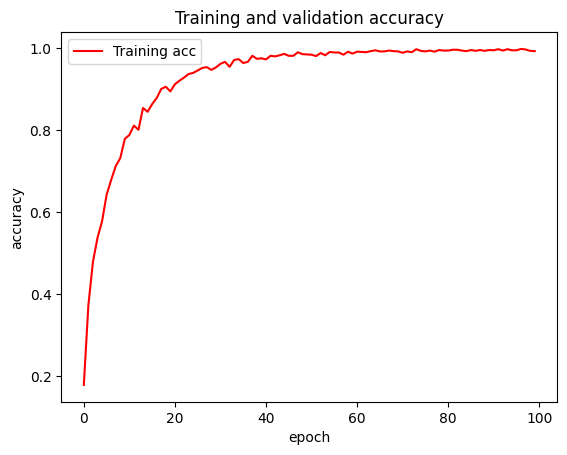

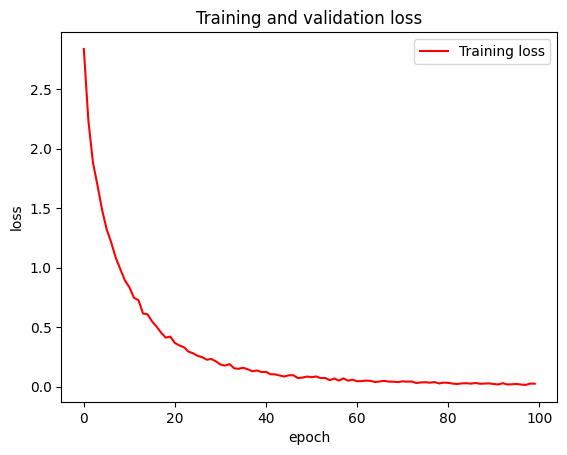

In [87]:
# plotting number of epochs vs accuracy
plt.plot(epochs, acc, "r", label="Training acc")
plt.title("Training accuracy")
plt.ylabel("accuracy") 
plt.xlabel("epoch")
plt.legend()
plt.figure()
# plotting number of epochs vs loss
plt.plot(epochs, loss, "r", label="Training loss")
plt.title("Training oss")
plt.ylabel("loss") 
plt.xlabel("epoch")
plt.legend()
plt.show()

In [88]:
# function for preprocessing test images
def read_image(file_path):
    print("[INFO] loading and preprocessing image…") 
    image = load_img(file_path, target_size=(224, 224)) 
    image = img_to_array(image) 
    image = np.expand_dims(image, axis=0)
    image /= 255. 
    return image

# Validation Predictions

In [89]:
# getting test images for predictions
images_test = []
images_names = []

for file in os.listdir(validation_data_dir):
    image_ = read_image(validation_data_dir + "/" + file)
    images_test.append(image_)
    images_names.append(file)

[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…
[INFO] loading and preprocessing image…


In [90]:
# preprocessing test images to match the train preprocessed images and getting the predictions
predictions = []
for img in images_test:
    images_new = vgg16.predict(img)
    prediction = model.predict_classes(images_new)
    predictions.append(prediction)

In [91]:
# mapping the predictions to the original labels
class_dictionary = generator_top.class_indices 
inv_map = {v: k for k, v in class_dictionary.items()} 

In [92]:
inv_map

{0: 'airplanes',
 1: 'bear',
 2: 'blimp',
 3: 'comet',
 4: 'crab',
 5: 'dog',
 6: 'dolphin',
 7: 'giraffe',
 8: 'goat',
 9: 'gorilla',
 10: 'kangaroo',
 11: 'killer-whale',
 12: 'leopards',
 13: 'llama',
 14: 'penguin',
 15: 'porcupine',
 16: 'teddy-bear',
 17: 'triceratops',
 18: 'unicorn',
 19: 'zebra'}

In [93]:
# getting the predictions with original labels
predictions_mapped = []

for prediction in predictions:
    predictions_mapped.append(inv_map[int(prediction[0])])

In [94]:
# making a dataframe for test image and prediction.
results = pd.DataFrame()
results["names"] = images_names
results["predictions"] = predictions_mapped

In [95]:
results

,names,predictions
0,validation_pic (1).jpg,penguin
1,validation_pic (10).jpg,goat
2,validation_pic (100).jpg,unicorn
3,validation_pic (101).jpg,goat
4,validation_pic (102).jpg,leopards
...,...,...
711,validation_pic (95).jpg,llama
712,validation_pic (96).jpg,llama
713,validation_pic (97).jpg,llama
714,validation_pic (98).jpg,goat


# Limitations


Vanishing gradient problems are common for the VGG16.
The model is very high in memory. Although it gives better accuracies, the vgg16 occupies a lot of memory.
This model is very slow compared to other models which makes it difficult to be used in mobile based architectures.